<a href="https://colab.research.google.com/github/ahatesham02/Image-Captioning-Bangla--Heliyon-Journal/blob/main/Code/Bornon_image_captioning_with_Attention%2B_BiGRU_with_zero_shot_test_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##New

In [ ]:


import string
import keras
from numpy import array
from pickle import load
from keras.preprocessing.text import Tokenizer
import matplotlib.pyplot as plt
from keras.backend import set_session
import sys, time, os, warnings
warnings.filterwarnings("ignore")
import re

import numpy as np
import pandas as pd
from PIL import Image
import pickle
from collections import Counter
from keras.utils import pad_sequences
from keras.utils import to_categorical
from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers import add
from keras.callbacks import ModelCheckpoint
from keras.utils import load_img, img_to_array
from sklearn.utils import shuffle
from keras.applications.vgg16 import VGG16, preprocess_input

from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
import zipfile
exfile= '/content/drive/MyDrive/Image Caption Generation /Bornon/Bornon Images-20221222T175856Z-001.zip'
zip_ref = zipfile.ZipFile(exfile, 'r')
zip_ref.extractall()
zip_ref.close()

In [ ]:
from os import listdir

image_dir = '/content/Bornon Images'
images = listdir(image_dir)

In [ ]:
len(images)

4106

In [ ]:
train_captions = load(open('/content/drive/MyDrive/Image Caption Generation /Bornon/bornon_captions.pkl', 'rb'))
img_name_vector = load(open('/content/drive/MyDrive/Image Caption Generation /Bornon/bornon_img_names.pkl', 'rb'))

In [ ]:
df = pd.DataFrame(list(zip(img_name_vector, train_captions)),
               columns =['filename', 'captions'])
df.head(10)

,filename,captions
0,/content/Bornon Images/1.jpg,<start> একটি পার্কে একটি লেক আছে <end>
1,/content/Bornon Images/1.jpg,<start> লেকের উপর একটি ব্রীজ আছে <end>
2,/content/Bornon Images/1.jpg,<start> গাছপালায় ঘেরা এই পার্কটি খুবই মনমু...
3,/content/Bornon Images/1.jpg,<start> লেকের উপর একটি ব্রীজ আছে <end>
4,/content/Bornon Images/1.jpg,<start> পানির উপর আকাশের প্রতিচ্ছবি দেখা যা...
5,/content/Bornon Images/2.jpg,<start> একজন মানুষ মাথায় খড় নিয়ে হেটে যা...
6,/content/Bornon Images/2.jpg,<start> একজন মানুষ ও দু টি খড়ের স্তূপ দেখা...
7,/content/Bornon Images/2.jpg,<start> লুঙ্গি পড়া একজন মানুষ খড়ের উপর হে...
8,/content/Bornon Images/2.jpg,<start> দুটি খড়ের স্তূপের পেছনে অনেক গাছপা...
9,/content/Bornon Images/2.jpg,<start> অনেক গাছপালার সামনে দুটি খড়ের স্তূ...


In [ ]:
filt =['<start>','<unk>','<end>']

In [ ]:
grouped_df = df.groupby('filename')['captions'].apply(list).reset_index(name='captions')
grouped_df['captions'] = [[caption.split() for caption in captions] for captions in grouped_df['captions']]

In [ ]:
grouped_df['captions'][4]

[['<start>', 'একটি', 'লোক', 'ঝর্ণার', 'সামনে', 'দারিয়ে', 'আছে', '<end>'],
 ['<start>',
  'একটি',
  'লোক',
  'পাহাড়ের',
  'সামনে',
  'দারিয়ে',
  'আছে',
  'এবং',
  'পাহাড়',
  'থেকে',
  'পানি',
  'পড়ছে',
  '<end>'],
 ['<start>',
  'পাহাড়',
  'থেকে',
  'পানি',
  'পড়ছে',
  'ঝর্ণার',
  'আকারে',
  'এবং',
  'একটি',
  'লোক',
  'দারিয়ে',
  'আছে',
  '<end>'],
 ['<start>',
  'একজন',
  'লোক',
  'পাহাড়ের',
  'সামনে',
  'দারিয়ে',
  'ঝর্ণা',
  'দেখছে',
  '<end>'],
 ['<start>', 'একজন', 'লোক', 'ঝর্ণার', 'দিকে', 'তাকিয়ে', 'আছে', '<end>']]

In [ ]:
grouped_df.head()

,filename,captions
0,/content/Bornon Images/1.jpg,"[[<start>, একটি, পার্কে, একটি, লেক, আছে, <end>..."
1,/content/Bornon Images/10.jpg,"[[<start>, একটি, লোহার, জালি, দেখা, যাচ্ছে, <e..."
2,/content/Bornon Images/100.jpg,"[[<start>, উরন্ত, একটি, পাখি, <end>], [<start>..."
3,/content/Bornon Images/1000.jpg,"[[<start>, একটি, বিড়াল, <end>], [<start>, বিড়..."
4,/content/Bornon Images/1001.jpg,"[[<start>, একটি, লোক, ঝর্ণার, সামনে, দারিয়ে, আ..."


In [ ]:
for i, row in grouped_df.iterrows():
    captions = row['captions']
    captions = [caption[1:-1] for caption in captions]
    grouped_df.at[i, 'captions'] = captions

In [ ]:
grouped_df['captions'][4]

[['একটি', 'লোক', 'ঝর্ণার', 'সামনে', 'দারিয়ে', 'আছে'],
 ['একটি',
  'লোক',
  'পাহাড়ের',
  'সামনে',
  'দারিয়ে',
  'আছে',
  'এবং',
  'পাহাড়',
  'থেকে',
  'পানি',
  'পড়ছে'],
 ['পাহাড়',
  'থেকে',
  'পানি',
  'পড়ছে',
  'ঝর্ণার',
  'আকারে',
  'এবং',
  'একটি',
  'লোক',
  'দারিয়ে',
  'আছে'],
 ['একজন', 'লোক', 'পাহাড়ের', 'সামনে', 'দারিয়ে', 'ঝর্ণা', 'দেখছে'],
 ['একজন', 'লোক', 'ঝর্ণার', 'দিকে', 'তাকিয়ে', 'আছে']]

In [ ]:
grouped_df.captions[6]

[['পাহাড়ের', 'উপর', 'অনেক', 'গুল', 'গাছ', 'আছে'],
 ['পাহাড়',
  'থেকে',
  'অনেক',
  'দূরে',
  'কুয়াশার',
  'মধ্যে',
  'আরও',
  'পাহাড়',
  'রয়েছে'],
 ['পাহাড়ের',
  'উপর',
  'অনেক',
  'গুলো',
  'গাছ',
  'আছে',
  'এবং',
  'গাছ',
  'গুলোর',
  'পিছনে',
  'কুয়াশা'],
 ['কুয়াশার', 'মধ্যে', 'অনেক', 'পাহাড়ের', 'সারি', 'রয়েছে'],
 ['পাহাড়ের', 'উপরের', 'গাছের', 'পাতা', 'গুলো', 'সবুজ']]

In [ ]:
train_data, test_data, train_caption, test_caption = train_test_split(img_name_vector, train_captions, test_size = 0.1, random_state = 42)

In [ ]:
len(train_data)

18395

In [ ]:
len(test_data)

2044

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50,preprocess_input

In [ ]:
image_model = ResNet50(include_top=False,weights='imagenet')
new_input = image_model.input
hidden_layer = image_model.layers[-1].output
image_features_extract_model = tf.compat.v1.keras.Model(new_input, hidden_layer)

94765736/94765736 [==============================] - 1s 0us/step


In [ ]:
image_features_extract_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                           

In [ ]:
preprocessed_image = []
IMAGE_SHAPE = (224, 224)

In [ ]:
for img in train_data[0:5] :
    img = tf.io.read_file(img, name=None)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    img = tf.keras.applications.resnet50.preprocess_input(img)
    preprocessed_image.append(img)

Shape after resize :  (224, 224, 3)
Shape after resize :  (224, 224, 3)
Shape after resize :  (224, 224, 3)
Shape after resize :  (224, 224, 3)
Shape after resize :  (224, 224, 3)


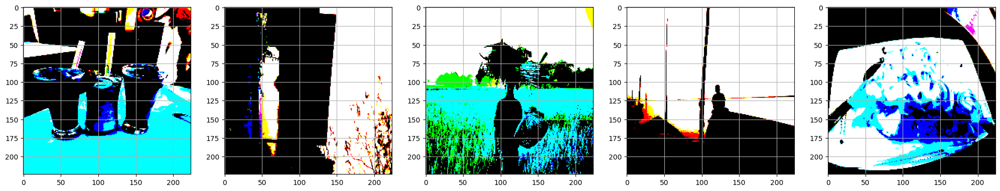

In [ ]:
# checking first five images post preprocessing
Display_Images = preprocessed_image[0:5]
figure, axes = plt.subplots(1,5)
figure.set_figwidth(25)
for ax, image in zip(axes, Display_Images) :
  print('Shape after resize : ', image.shape)
  ax.imshow(image)
  ax.grid('off')

Shape after resize : (224, 224, 3)


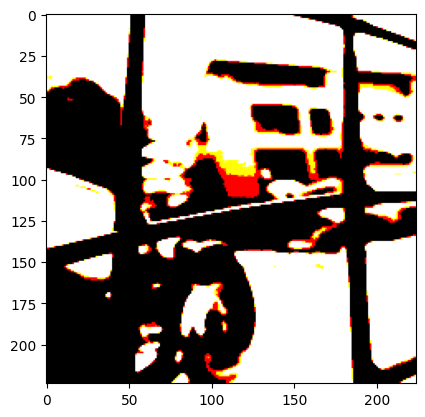

In [ ]:
def load_images(image_path) :
  img = tf.io.read_file(image_path, name = None)
  img = tf.image.decode_jpeg(img, channels=3)
  img = tf.image.resize(img, IMAGE_SHAPE)
  img = preprocess_input(img)
  return img, image_path

img1,img1_path = load_images("/content/Bornon Images/10.jpg")
print("Shape after resize :", img1.shape)
plt.imshow(img1)

## Tokenizer and Vocabulary

In [ ]:
tokenizer = tf.keras.preprocessing.text.Tokenizer(
                                                 oov_token="<unk>",
                                                 filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')

tokenizer.fit_on_texts(train_caption)
train_seqs = tokenizer.texts_to_sequences(train_caption)
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

train_seqs = tokenizer.texts_to_sequences(train_caption)
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
vocab_size = len(tokenizer.index_word)+1

In [ ]:
vocab_size

5568

In [ ]:
train_caption[:3]

['<start>    একটি কোল্ড কফির রং হলুদ   <end>',
 '<start>    একটি সাইনবোর্ডে লেকের সতর্কীকরণ বিজ্ঞপ্তি দেওয়া আছে   <end>',
 '<start>    ফসলের মাঠে কৃষক কে দেখা যাচ্ছে   <end>']

In [ ]:
train_seqs[:3]

[[2, 4, 2527, 1277, 103, 64, 3],
 [2, 4, 1427, 472, 2528, 3412, 840, 5, 3],
 [2, 775, 174, 727, 679, 7, 6, 3]]

In [ ]:
tokenizer.index_word

{1: '<unk>',
 2: '<start>',
 3: '<end>',
 4: 'একটি',
 5: 'আছে',
 6: 'যাচ্ছে',
 7: 'দেখা',
 8: 'কিছু',
 9: 'একজন',
 10: 'মানুষ',
 11: 'রয়েছে',
 12: 'ছবি',
 13: 'সাদা',
 14: 'বসে',
 15: 'ও',
 16: 'খাবার',
 17: 'উপর',
 18: 'অনেক',
 19: 'এবং',
 20: 'গাছ',
 21: 'বাটিতে',
 22: 'ফুল',
 23: 'দুটি',
 24: 'রঙের',
 25: 'সবুজ',
 26: 'পাশে',
 27: 'এর',
 28: 'কুকুর',
 29: 'গাছপালা',
 30: 'রাখা',
 31: 'লাল',
 32: 'কালো',
 33: 'লোক',
 34: 'পাখি',
 35: 'নৌকা',
 36: 'অনেকগুলো',
 37: 'পাতা',
 38: 'আকাশ',
 39: 'গাছের',
 40: 'আকাশে',
 41: 'নীল',
 42: 'প্লেটে',
 43: 'দাঁড়িয়ে',
 44: 'দালান',
 45: 'দারিয়ে',
 46: 'দৃশ্যমান',
 47: 'সামনে',
 48: 'বিড়াল',
 49: 'বাটি',
 50: 'মধ্যে',
 51: 'দুইটি',
 52: 'রাস্তার',
 53: 'নদীর',
 54: 'উপরে',
 55: 'দিয়ে',
 56: 'ছেলে',
 57: 'কয়েকটি',
 58: 'রাস্তা',
 59: 'রয়েছে',
 60: 'প্লেট',
 61: 'রাস্তায়',
 62: 'প্লেটের',
 63: 'করা',
 64: 'হলুদ',
 65: 'ওপর',
 66: 'করছে',
 67: 'শিশু',
 68: 'মেঘ',
 69: 'তিনটি',
 70: 'ছোট',
 71: 'দালানের',
 72: 'নিচে',
 73: 'দূরে',
 74: 'টেবিলের',
 75: 

In [ ]:
# Pad each vector to the max_length of the captions  store it to a vairable

train_seqs_len = [len(seq) for seq in train_seqs]

longest_word_length = max(train_seqs_len)

cap_vector= tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding= 'post', maxlen = longest_word_length,
                                                          dtype='int32', value=0)
print("The shape of Caption vector is :" + str(cap_vector.shape))

The shape of Caption vector is :(18395, 23)


In [ ]:
cap_vector

array([[   2,    4, 2527, ...,    0,    0,    0],
       [   2,    4, 1427, ...,    0,    0,    0],
       [   2,  775,  174, ...,    0,    0,    0],
       ...,
       [   2,    4,  868, ...,    0,    0,    0],
       [   2,    4,  624, ...,    0,    0,    0],
       [   2,   35,   51, ...,    0,    0,    0]], dtype=int32)

## Creating Dataset

In [ ]:
# Map each image full path to the function, in order to preprocess the image
training_list = sorted(set(train_data))
New_Img = tf.data.Dataset.from_tensor_slices(training_list)
New_Img = New_Img.map(load_images, num_parallel_calls = tf.data.experimental.AUTOTUNE)
New_Img = New_Img.batch(64, drop_remainder=False)

In [ ]:
path_train, path_test, caption_train, caption_test = train_test_split(train_data, cap_vector, test_size = 0.1, random_state = 42)

In [ ]:
print("Training data for images: " + str(len(path_train)))
print("Testing data for images: " + str(len(path_test)))
print("Training data for Captions: " + str(len(caption_train)))
print("Testing data for Captions: " + str(len(caption_test)))

Training data for images: 16555
Testing data for images: 1840
Training data for Captions: 16555
Testing data for Captions: 1840


In [ ]:
from tqdm import tqdm

In [ ]:
New_Img

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.string, name=None))>

In [ ]:
# extract features from each image in the dataset
img_features = {}
for image, image_path in tqdm(New_Img) :
  batch_features = image_features_extract_model(image)
  #squeeze out the features in a batch
  batch_features_flattened = tf.reshape(batch_features, (batch_features.shape[0], -1, batch_features.shape[3]))
  for batch_feat, path in zip(batch_features_flattened, image_path) :
    feature_path = path.numpy().decode('utf-8')
    img_features[feature_path] = batch_feat.numpy()

100%|██████████| 64/64 [00:28<00:00,  2.28it/s]


In [ ]:
batch_features

<tf.Tensor: shape=(56, 7, 7, 2048), dtype=float32, numpy=
array([[[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          4.54157162e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          5.90652561e+00, 0.00000000e+00, 0.00000000e+00]],

        [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         

In [ ]:
batch_features_flattened

<tf.Tensor: shape=(56, 49, 2048), dtype=float32, numpy=
array([[[0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        ...,
        [0.0000000e+00, 3.1912310e+00, 0.0000000e+00, ...,
         0.0000000e+00, 2.5829935e-01, 0.0000000e+00],
        [0.0000000e+00, 3.2578123e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 7.6247768e+00, 0.0000000e+00]],

       [[0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.0000000e+00, 0.0000000e+00, 0.0000000e+00, ...,
         0.0000000e+00, 0.0000000e+00, 0.0000000e+00],
        [0.000000

In [ ]:
batch_feat.shape

TensorShape([49, 2048])

In [ ]:
img_features

{'/content/Bornon Images/1.jpg': array([[0.       , 6.830829 , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        ...,
        [0.       , 0.       , 0.       , ..., 5.6680636, 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 4.2779784, 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.5705113, 0.       ,
         0.       ]], dtype=float32),
 '/content/Bornon Images/10.jpg': array([[0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        [0.       , 0.       , 0.       , ..., 0.       , 0.       ,
         0.       ],
        ...,
        [1.3948975, 0.5629126, 0.       , ..., 8.5626955, 1.3041704,
         0.  

In [ ]:
#to provide, both images along with the captions as input
def map(image_name, caption):
    img_tensor = img_features[image_name.decode('utf-8')]
    return img_tensor, caption

In [ ]:
# This function should transform the created dataset(img_path,cap) to (features,cap) using the map_func created earlier
BUFFER_SIZE = 1000
BATCH_SIZE = 64
def gen_dataset(img, capt):

    data = tf.data.Dataset.from_tensor_slices((img, capt))
    data = data.map(lambda ele1, ele2 : tf.numpy_function(map, [ele1, ele2], [tf.float32, tf.int32]),
                    num_parallel_calls = tf.data.experimental.AUTOTUNE)


    data = (data.shuffle(BUFFER_SIZE, reshuffle_each_iteration= True).batch(BATCH_SIZE, drop_remainder = False)
    .prefetch(tf.data.experimental.AUTOTUNE))
    return data

In [ ]:
train_dataset = gen_dataset(path_train,caption_train)
test_dataset = gen_dataset(path_test,caption_test)

In [ ]:
sample_img_batch, sample_cap_batch = next(iter(train_dataset))
print(sample_img_batch.shape)  #(batch_size, 7*7, 2048)
print(sample_cap_batch.shape) #(batch_size,max_len)

(64, 49, 2048)
(64, 23)


In [ ]:
embedding_dim = 256
units = 512
vocab_size = vocab_size
train_num_steps = len(path_train) // BATCH_SIZE
test_num_steps = len(path_test) // BATCH_SIZE
EPOCHS = 20
max_length = 23
feature_shape = batch_feat.shape[1]
attention_feature_shape = batch_feat.shape[0]

In [ ]:
vocab_size

5568

In [ ]:
feature_shape

2048

In [ ]:
attention_feature_shape

49

## CNN Encoder

In [ ]:
from keras.utils.vis_utils import plot_model

In [ ]:
tf.compat.v1.reset_default_graph()
print(tf.compat.v1.get_default_graph())

In [ ]:
#Building Encoder using CNN Keras subclassing method

class Encoder(Model):
    def __init__(self,embed_dim):
        super(Encoder, self).__init__()
        self.dense = tf.keras.layers.Dense(embed_dim) #build your Dense layer with relu activation

    def call(self, features):
        features =  self.dense(features) # extract the features from the image shape: (batch, 8*8, embed_dim)
        features =  tf.keras.activations.relu(features, alpha=0.01, max_value=None, threshold=0)
        return features

In [ ]:
encoder=Encoder(embedding_dim)

## Attention Model

In [ ]:
class Attention(Model):
    def __init__(self, units):
        super(Attention, self).__init__()
        self.units=units
        self.W1 = tf.keras.layers.Dense(units)
        self.W2 = tf.keras.layers.Dense(units)
        self.V = tf.keras.layers.Dense(1)


    def call(self, features, hidden):
        hidden_with_time_axis = hidden[:, tf.newaxis]
        score = tf.keras.activations.tanh(self.W1(features) + self.W2(hidden_with_time_axis))
        attention_weights = tf.keras.activations.softmax(self.V(score), axis=1)
        context_vector = attention_weights * features
        context_vector = tf.reduce_sum(context_vector, axis=1)
        return context_vector, attention_weights

In [ ]:
class Decoder(Model):
    def __init__(self, embed_dim, units, vocab_size):
        super(Decoder, self).__init__()
        self.units=units
        self.attention = Attention(self.units) #iniitalise your Attention model with units
        self.embed = tf.keras.layers.Embedding(vocab_size, embed_dim) #build your Embedding layer
        self.gru = tf.keras.layers.Bidirectional(tf.keras.layers.GRU(self.units,return_sequences=True,return_state=True,recurrent_initializer='glorot_uniform'))
        self.d1 = tf.keras.layers.Dense(self.units) #build your Dense layer
        self.d2 = tf.keras.layers.Dense(vocab_size) #build your Dense layer


    def call(self,x,features, hidden):
        context_vector, attention_weights = self.attention(features, hidden) #create your context vector & attention weights from attention model
        embed = self.embed(x) # embed your input to shape: (batch_size, 1, embedding_dim)
        embed = tf.concat([tf.expand_dims(context_vector, 1), embed], axis = -1) # Concatenate your input with the context vector from attention layer. Shape: (batch_size, 1, embedding_dim + embedding_dim)
        output,state,_ = self.gru(embed) # Extract the output & hidden state from GRU layer. Output shape : (batch_size, max_length, hidden_size)
        output = self.d1(output)
        output = tf.reshape(output, (-1, output.shape[2])) # shape : (batch_size * max_length, hidden_size)
        output = self.d2(output) # shape : (batch_size * max_length, vocab_size)
        return output, state, attention_weights

    def init_state(self, batch_size):
        return tf.zeros((batch_size, self.units))

In [ ]:
class Decoder2(Model):
    def __init__(self, embed_dim, units, vocab_size):
        super(Decoder2, self).__init__()
        self.units=units
        self.attention = Attention(self.units) #iniitalise your Attention model with units
        self.embed = tf.keras.layers.Embedding(vocab_size, embed_dim) #build your Embedding layer
        self.gru = tf.keras.layers.Bidirectional(tf.keras.layers.GRU(self.units,return_sequences=True,return_state=True,recurrent_initializer='glorot_uniform'))
        self.d1 = tf.keras.layers.Dense(self.units) #build your Dense layer
        self.d2 = tf.keras.layers.Dense(vocab_size) #build your Dense layer


    def call(self,x,features, hidden):
        context_vector, attention_weights = self.attention(features, hidden) #create your context vector & attention weights from attention model
        embed = self.embed(x) # embed your input to shape: (batch_size, 1, embedding_dim)
        embed = tf.concat([tf.expand_dims(context_vector, 1), embed], axis = -1) # Concatenate your input with the context vector from attention layer. Shape: (batch_size, 1, embedding_dim + embedding_dim)
        output,state_f,state_b = self.gru(embed) # Extract the output & hidden state from GRU layer. Output shape : (batch_size, max_length, hidden_size)
        #print(output.shape)
        #print(state_f.shape)
        #print(state_b.shape)
        state = tf.keras.layers.Add()([state_f, state_b])
        #print(state.shape)
        output = self.d1(output)
        output = tf.reshape(output, (-1, output.shape[2])) # shape : (batch_size * max_length, hidden_size)
        output = self.d2(output) # shape : (batch_size * max_length, vocab_size)
        return output, state, attention_weights

    def init_state(self, batch_size):
        return tf.zeros((batch_size, self.units))

In [ ]:
decoder=Decoder2(embedding_dim, units, vocab_size)

In [ ]:
features=encoder(sample_img_batch)

hidden = decoder.init_state(batch_size=sample_cap_batch.shape[0])
dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * sample_cap_batch.shape[0], 1)

predictions, hidden_out, attention_weights= decoder(dec_input, features, hidden)
print('Feature shape from Encoder: {}'.format(features.shape)) #(batch, 8*8, embed_dim)
print('Predcitions shape from Decoder: {}'.format(predictions.shape)) #(batch,vocab_size)
print('Attention weights shape from Decoder: {}'.format(attention_weights.shape)) #(batch, 8*8, embed_dim

Feature shape from Encoder: (64, 49, 256)
Predcitions shape from Decoder: (64, 5568)
Attention weights shape from Decoder: (64, 49, 1)


In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)  #define the optimizer
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(from_logits = True, reduction = tf.keras.losses.Reduction.NONE)

In [ ]:
def loss_function(real, pred):
    mask = tf.math.logical_not(tf.math.equal(real, 0))
    loss_ = loss_object(real, pred)

    mask = tf.cast(mask, dtype=loss_.dtype)
    loss_ *= mask
    #loss is getting multiplied with mask to get an ideal shape

    return tf.reduce_mean(loss_)

In [ ]:
checkpoint_path = "/content/drive/MyDrive/Image Caption Generation /Bornon/Models/Attention + Bigru/"
ckpt = tf.train.Checkpoint(encoder=encoder,
                           decoder=decoder,
                           optimizer = optimizer)
ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=5)

In [ ]:
start_epoch = 0
if ckpt_manager.latest_checkpoint:
    start_epoch = int(ckpt_manager.latest_checkpoint.split('-')[-1])

In [ ]:
@tf.function
def train_step(img_tensor, target):
    loss = 0
    hidden = decoder.init_state(batch_size=target.shape[0])
    dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * target.shape[0], 1)

    with tf.GradientTape() as tape:

        encoder_op = encoder(img_tensor)
        for r in range(1, target.shape[1]) :
          predictions, hidden, _ = decoder(dec_input, encoder_op, hidden)
          loss = loss + loss_function(target[:, r], predictions)
          dec_input = tf.expand_dims(target[:, r], 1)

    avg_loss = (loss/ int(target.shape[1])) #avg loss per batch
    trainable_vars = encoder.trainable_variables + decoder.trainable_variables
    grad = tape.gradient (loss, trainable_vars)
    optimizer.apply_gradients(zip(grad, trainable_vars))

    return loss, avg_loss

In [ ]:
@tf.function
def test_step(img_tensor, target):
    loss = 0
    hidden = decoder.init_state(batch_size = target.shape[0])
    dec_input = tf.expand_dims([tokenizer.word_index['<start>']] * target.shape[0], 1)
    with tf.GradientTape() as tape:
      encoder_op = encoder(img_tensor)
      for r in range(1, target.shape[1]) :
        predictions, hidden, _ = decoder(dec_input, encoder_op, hidden)
        loss = loss + loss_function(target[:, r], predictions)
        dec_input = tf.expand_dims(target[: , r], 1)
    avg_loss = (loss/ int(target.shape[1])) #avg loss per batch
    trainable_vars = encoder.trainable_variables + decoder.trainable_variables
    grad = tape.gradient (loss, trainable_vars)
    optimizer.apply_gradients(zip(grad, trainable_vars))
    return loss, avg_loss

In [ ]:
def test_loss_cal(test_dataset):
    total_loss = 0
    for (batch, (img_tensor, target)) in enumerate(test_dataset) :
      batch_loss, t_loss = test_step(img_tensor, target)
      total_loss = total_loss + t_loss
      avg_test_loss = total_loss/ test_num_steps

    return avg_test_loss

In [ ]:
loss_plot = []
test_loss_plot = []
EPOCHS = 30
best_test_loss=100
for epoch in tqdm(range(0, EPOCHS)):
    start = time.time()
    total_loss = 0
    for (batch, (img_tensor, target)) in enumerate(train_dataset):
        batch_loss, t_loss = train_step(img_tensor, target)
        total_loss += t_loss
        avg_train_loss=total_loss / train_num_steps
    loss_plot.append(avg_train_loss)
    test_loss = test_loss_cal(test_dataset)
    test_loss_plot.append(test_loss)
    print ('For epoch: {}, the train loss is {:.3f}, & test loss is {:.3f}'.format(epoch+1,avg_train_loss,test_loss))
    print ('Time taken for 1 epoch {} sec\n'.format(time.time() - start))
    if test_loss < best_test_loss:
        print('Test loss has been reduced from %.3f to %.3f' % (best_test_loss, test_loss))
        best_test_loss = test_loss
        ckpt_manager.save()

  0%|          | 0/30 [00:00<?, ?it/s]

For epoch: 1, the train loss is 1.226, & test loss is 1.058
Time taken for 1 epoch 175.31449556350708 sec

Test loss has been reduced from 100.000 to 1.058


  3%|▎         | 1/30 [02:55<1:24:56, 175.73s/it]

For epoch: 2, the train loss is 0.905, & test loss is 0.840
Time taken for 1 epoch 25.222044706344604 sec

Test loss has been reduced from 1.058 to 0.840


  7%|▋         | 2/30 [03:21<40:47, 87.42s/it]   

For epoch: 3, the train loss is 0.731, & test loss is 0.684
Time taken for 1 epoch 25.02952289581299 sec

Test loss has been reduced from 0.840 to 0.684


 10%|█         | 3/30 [03:46<26:35, 59.08s/it]

For epoch: 4, the train loss is 0.611, & test loss is 0.577
Time taken for 1 epoch 24.426494121551514 sec

Test loss has been reduced from 0.684 to 0.577


 13%|█▎        | 4/30 [04:11<19:43, 45.54s/it]

For epoch: 5, the train loss is 0.523, & test loss is 0.496
Time taken for 1 epoch 24.659926176071167 sec

Test loss has been reduced from 0.577 to 0.496


 17%|█▋        | 5/30 [04:36<15:53, 38.13s/it]

For epoch: 6, the train loss is 0.458, & test loss is 0.438
Time taken for 1 epoch 24.166174173355103 sec

Test loss has been reduced from 0.496 to 0.438


 20%|██        | 6/30 [05:01<13:24, 33.51s/it]

For epoch: 7, the train loss is 0.406, & test loss is 0.388
Time taken for 1 epoch 24.543238878250122 sec

Test loss has been reduced from 0.438 to 0.388


 23%|██▎       | 7/30 [05:25<11:46, 30.70s/it]

For epoch: 8, the train loss is 0.360, & test loss is 0.342
Time taken for 1 epoch 24.50054383277893 sec

Test loss has been reduced from 0.388 to 0.342


 27%|██▋       | 8/30 [05:50<10:34, 28.84s/it]

For epoch: 9, the train loss is 0.324, & test loss is 0.307
Time taken for 1 epoch 24.77183437347412 sec

Test loss has been reduced from 0.342 to 0.307


 30%|███       | 9/30 [06:15<09:41, 27.68s/it]

For epoch: 10, the train loss is 0.291, & test loss is 0.271
Time taken for 1 epoch 24.947093725204468 sec

Test loss has been reduced from 0.307 to 0.271


 33%|███▎      | 10/30 [06:41<08:58, 26.94s/it]

For epoch: 11, the train loss is 0.262, & test loss is 0.244
Time taken for 1 epoch 24.950422525405884 sec

Test loss has been reduced from 0.271 to 0.244


 37%|███▋      | 11/30 [07:06<08:22, 26.43s/it]

For epoch: 12, the train loss is 0.237, & test loss is 0.219
Time taken for 1 epoch 25.064728260040283 sec

Test loss has been reduced from 0.244 to 0.219


 40%|████      | 12/30 [07:31<07:50, 26.12s/it]

For epoch: 13, the train loss is 0.213, & test loss is 0.203
Time taken for 1 epoch 24.65812063217163 sec

Test loss has been reduced from 0.219 to 0.203


 43%|████▎     | 13/30 [07:56<07:18, 25.78s/it]

For epoch: 14, the train loss is 0.197, & test loss is 0.184
Time taken for 1 epoch 24.744922399520874 sec

Test loss has been reduced from 0.203 to 0.184


 47%|████▋     | 14/30 [08:21<06:49, 25.57s/it]

For epoch: 15, the train loss is 0.182, & test loss is 0.173
Time taken for 1 epoch 24.747135877609253 sec

Test loss has been reduced from 0.184 to 0.173


 50%|█████     | 15/30 [08:47<06:21, 25.42s/it]

For epoch: 16, the train loss is 0.172, & test loss is 0.162
Time taken for 1 epoch 24.700441122055054 sec

Test loss has been reduced from 0.173 to 0.162


 57%|█████▋    | 17/30 [09:36<05:26, 25.15s/it]

For epoch: 17, the train loss is 0.163, & test loss is 0.162
Time taken for 1 epoch 24.760146617889404 sec

For epoch: 18, the train loss is 0.154, & test loss is 0.146
Time taken for 1 epoch 24.77309513092041 sec

Test loss has been reduced from 0.162 to 0.146


 60%|██████    | 18/30 [10:01<05:01, 25.14s/it]

For epoch: 19, the train loss is 0.148, & test loss is 0.140
Time taken for 1 epoch 24.60533356666565 sec

Test loss has been reduced from 0.146 to 0.140


 63%|██████▎   | 19/30 [10:26<04:35, 25.07s/it]

For epoch: 20, the train loss is 0.143, & test loss is 0.133
Time taken for 1 epoch 24.561366081237793 sec

Test loss has been reduced from 0.140 to 0.133


 67%|██████▋   | 20/30 [10:51<04:10, 25.02s/it]

For epoch: 21, the train loss is 0.137, & test loss is 0.129
Time taken for 1 epoch 24.5345618724823 sec

Test loss has been reduced from 0.133 to 0.129


 70%|███████   | 21/30 [11:16<03:44, 24.97s/it]

For epoch: 22, the train loss is 0.134, & test loss is 0.124
Time taken for 1 epoch 24.75025963783264 sec

Test loss has been reduced from 0.129 to 0.124


 73%|███████▎  | 22/30 [11:41<03:19, 25.00s/it]

For epoch: 23, the train loss is 0.132, & test loss is 0.120
Time taken for 1 epoch 24.591014862060547 sec

Test loss has been reduced from 0.124 to 0.120


 77%|███████▋  | 23/30 [12:06<02:54, 24.97s/it]

For epoch: 24, the train loss is 0.129, & test loss is 0.120
Time taken for 1 epoch 24.77388620376587 sec

Test loss has been reduced from 0.120 to 0.120


 83%|████████▎ | 25/30 [12:56<02:04, 24.87s/it]

For epoch: 25, the train loss is 0.127, & test loss is 0.121
Time taken for 1 epoch 24.508994102478027 sec



 87%|████████▋ | 26/30 [13:20<01:39, 24.83s/it]

For epoch: 26, the train loss is 0.124, & test loss is 0.123
Time taken for 1 epoch 24.732849597930908 sec

For epoch: 27, the train loss is 0.123, & test loss is 0.118
Time taken for 1 epoch 24.858312606811523 sec

Test loss has been reduced from 0.120 to 0.118


 90%|█████████ | 27/30 [13:46<01:14, 24.94s/it]

For epoch: 28, the train loss is 0.119, & test loss is 0.111
Time taken for 1 epoch 24.71660852432251 sec

Test loss has been reduced from 0.118 to 0.111


 97%|█████████▋| 29/30 [14:36<00:24, 24.94s/it]

For epoch: 29, the train loss is 0.118, & test loss is 0.114
Time taken for 1 epoch 24.86089015007019 sec



100%|██████████| 30/30 [15:00<00:00, 30.03s/it]

For epoch: 30, the train loss is 0.117, & test loss is 0.112
Time taken for 1 epoch 24.80108332633972 sec



In [ ]:
ckpt_manager.checkpoints

['/content/drive/MyDrive/Image Caption Generation /Bornon/Models/Attention + Bigru/ckpt-21',
 '/content/drive/MyDrive/Image Caption Generation /Bornon/Models/Attention + Bigru/ckpt-22',
 '/content/drive/MyDrive/Image Caption Generation /Bornon/Models/Attention + Bigru/ckpt-23',
 '/content/drive/MyDrive/Image Caption Generation /Bornon/Models/Attention + Bigru/ckpt-24',
 '/content/drive/MyDrive/Image Caption Generation /Bornon/Models/Attention + Bigru/ckpt-25']

In [ ]:
ckpt.restore('/content/drive/MyDrive/Image Caption Generation /Bornon/Models/Attention + Bigru shape/ckpt-25')

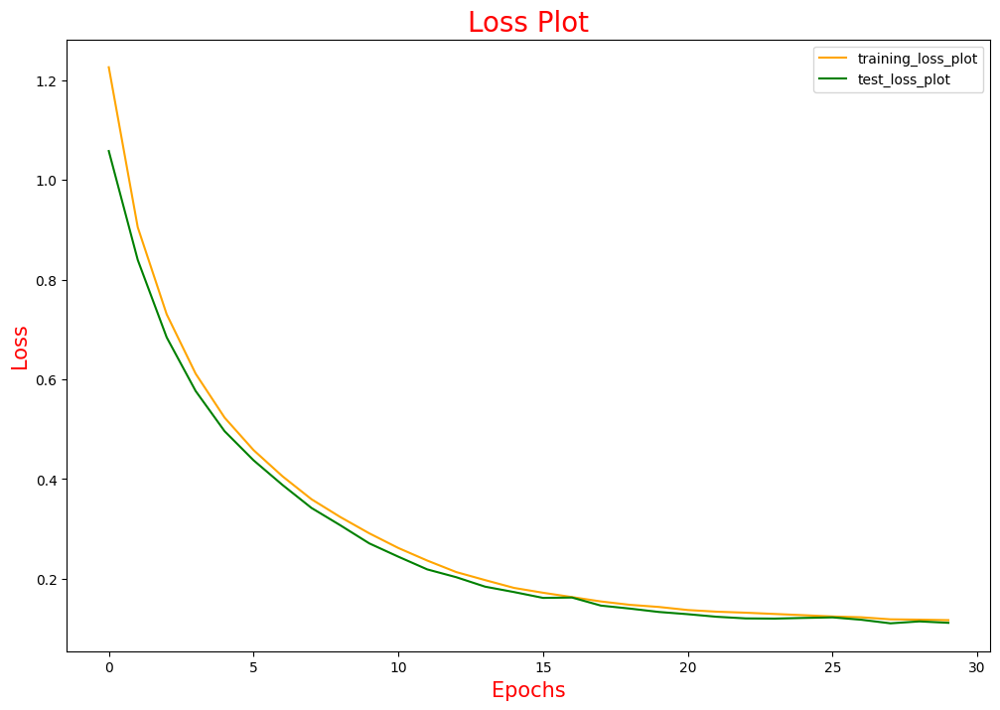

In [ ]:
from matplotlib.pyplot import figure
figure(figsize=(12, 8))
plt.plot(loss_plot, color='orange', label = 'training_loss_plot')
plt.plot(test_loss_plot, color='green', label = 'test_loss_plot')
plt.xlabel('Epochs', fontsize = 15, color = 'red')
plt.ylabel('Loss', fontsize = 15, color = 'red')
plt.title('Loss Plot', fontsize = 20, color = 'red')
plt.legend()
plt.show()

In [ ]:
attention_feature_shape

49

In [ ]:
import matplotlib.font_manager as fm
import matplotlib.pyplot as plt
font_path = '/content/drive/MyDrive/Image Caption Generation /SolaimanLipi_20-04-07.ttf'
prop = fm.FontProperties(fname=font_path)

In [ ]:
def evaluate(image):
    attention_plot = np.zeros((max_length, attention_feature_shape))

    hidden = decoder.init_state(batch_size=1)

    temp_input = tf.expand_dims(load_images(image)[0], 0)
    img_tensor_val = image_features_extract_model(temp_input)
    img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))

    features = encoder (img_tensor_val)

    dec_input = tf.expand_dims([tokenizer.word_index['<start>']], 0)
    result = []

    for i in range(max_length):
        predictions, hidden, attention_weights = decoder(dec_input, features, hidden)
        attention_plot[i] = tf.reshape(attention_weights, (-1, )).numpy()

        predicted_id = tf.argmax(predictions[0]).numpy()
        result.append (tokenizer.index_word[predicted_id])

        if tokenizer.index_word[predicted_id] == '<end>':
            return result, attention_plot,predictions

        dec_input = tf.expand_dims([predicted_id], 0)

    attention_plot = attention_plot[:len(result), :]
    return result, attention_plot,predictions

In [ ]:
def plot_attention_map(caption, weights, image) :

  fig = plt.figure(figsize = (12, 12))
  temp_img = np.array(Image.open(image))

  cap_len = len(caption)
  for cap in range(len(caption)) :
    weights_img = np.reshape(weights[cap], (7,7))
    wweights_img = np.array(Image.fromarray(weights_img).resize((224,224), Image.LANCZOS))

    ax = fig.add_subplot(cap_len//2, cap_len//2, cap+1)
    ax.set_title(caption[cap], fontsize = 24, color = 'red',fontproperties=prop)

    img = ax.imshow(temp_img)

    ax.imshow(weights_img, cmap='gray', alpha=0.6, extent=img.get_extent())
    ax.axis('off')
  plt.subplots_adjust(hspace=0.2, wspace=0.2)
  plt.show()

In [ ]:
def filt_text(text):
    filt=['<start>','<unk>','<end>']
    temp= text.split()
    [temp.remove(j) for k in filt for j in temp if k==j]
    text=' '.join(temp)
    return text

In [ ]:
image_test = path_test.copy()

In [ ]:
from nltk.translate.bleu_score import sentence_bleu, corpus_bleu, SmoothingFunction

In [ ]:
import nltk
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

In [ ]:
from nltk.translate.meteor_score import meteor_score

In [ ]:
encoder.save_weights('content/outputs_encoder')
decoder.save_weights('.content/outputs_decoder')

In [ ]:
path_test

['/content/Bornon Images/3833.jpg',
 '/content/Bornon Images/2454.jpg',
 '/content/Bornon Images/3691.jpg',
 '/content/Bornon Images/2651.jpg',
 '/content/Bornon Images/3936.jpg',
 '/content/Bornon Images/128.jpg',
 '/content/Bornon Images/399.jpg',
 '/content/Bornon Images/344.jpg',
 '/content/Bornon Images/2028.jpg',
 '/content/Bornon Images/4038.jpg',
 '/content/Bornon Images/2230.jpg',
 '/content/Bornon Images/3363.jpg',
 '/content/Bornon Images/3006.jpg',
 '/content/Bornon Images/2246.jpg',
 '/content/Bornon Images/3180.jpg',
 '/content/Bornon Images/1184.jpg',
 '/content/Bornon Images/3652.jpg',
 '/content/Bornon Images/3272.jpg',
 '/content/Bornon Images/688.jpg',
 '/content/Bornon Images/2186.jpg',
 '/content/Bornon Images/369.jpg',
 '/content/Bornon Images/2121.jpg',
 '/content/Bornon Images/3868.jpg',
 '/content/Bornon Images/1641.jpg',
 '/content/Bornon Images/1702.jpg',
 '/content/Bornon Images/2834.jpg',
 '/content/Bornon Images/531.jpg',
 '/content/Bornon Images/1188.jpg'

BLEU-1: 50.000000
BLEU-2: 40.824829
BLEU-3: 20.621275
BLEU-4: 16.821895
Meteor Score: 0.604839
Real Caption: অনেক গাছপালা আছে
Prediction Caption: পানিতে অনেক গাছপালা রয়েছে


ValueError: ignored

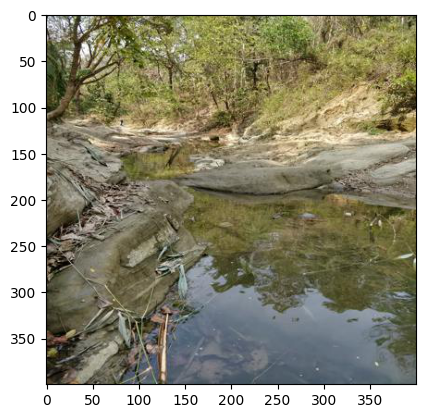

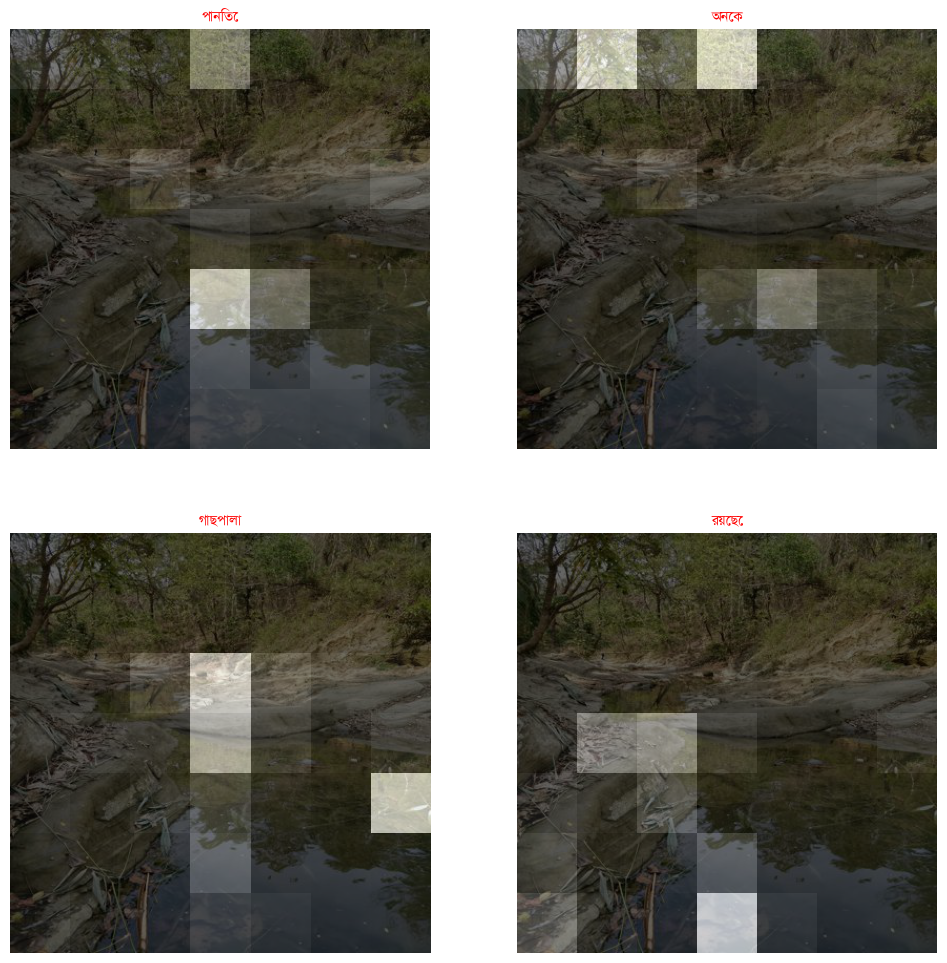

In [ ]:
cap_test_data = caption_test.copy()
rid = 101

test_image= path_test[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_test_data[rid] if i not in [0]])
result, attention_plot, pred_test = evaluate(test_image)
real_caption=filt_text(real_caption)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)
score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)

print ('Real Caption:', real_caption)
print ('Prediction Caption:', pred_caption)

plot_attention_map(result, attention_plot, test_image)


In [ ]:
len(test_data)

## Evaluation

Real Caption: ['একটি বাটি আছে', 'একটি বাটিতে খাবার আছে', 'একটি বাটিতে এক টুকরা খাবার আছে', 'একটি টেবিলে একটি বাটিতে খাবার আছে', 'একটি বাটিতে চামচ আছে']
Prediction Caption: একটি বাটিতে খাবার আছে
BLEU-1: 100.000000
BLEU-2: 100.000000
BLEU-3: 100.000000
BLEU-4: 100.000000
Meteor Score: 0.992188


ValueError: ignored

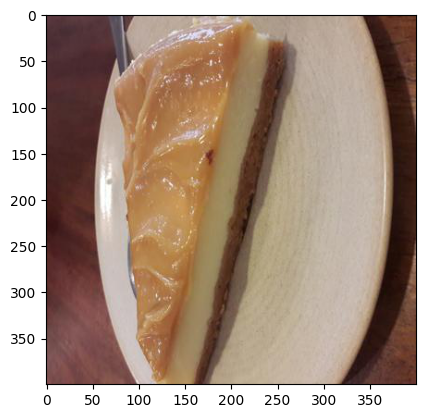

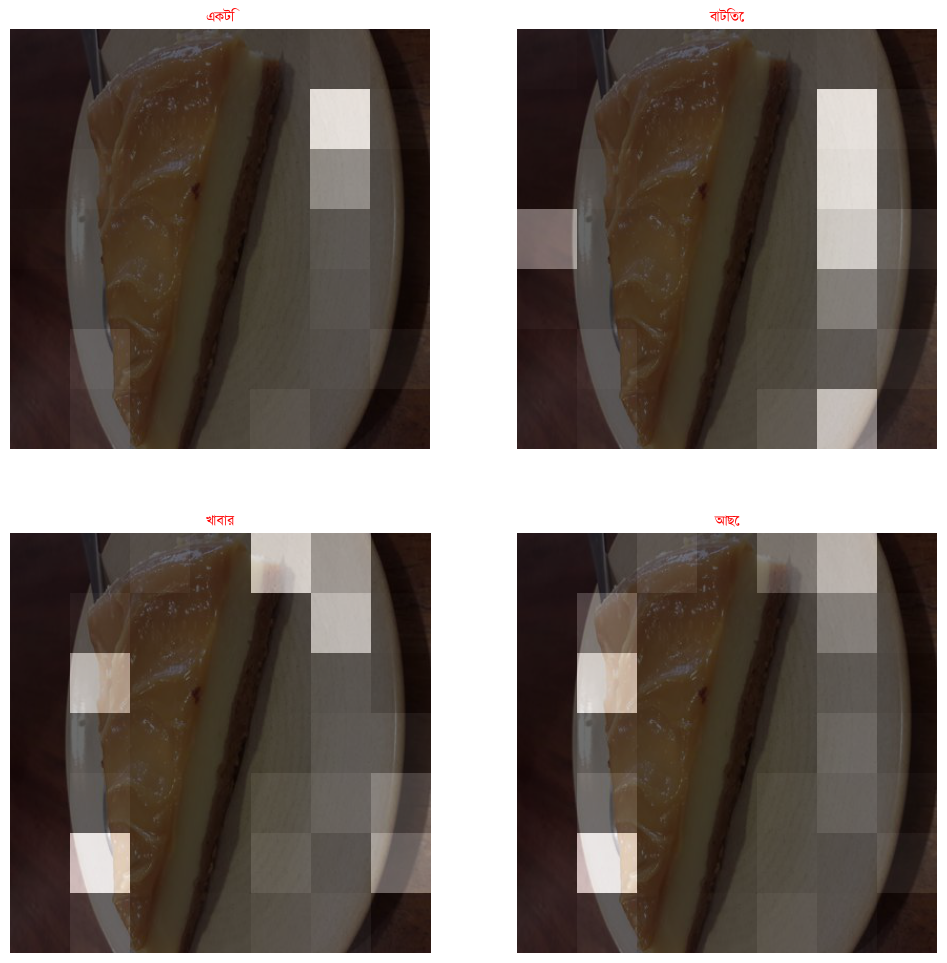

In [ ]:
cap_test_data = test_caption.copy()
rid = np.random.randint(0, len(test_data))
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি শিশু আছে', 'একটি ছেলে তাকিয়ে আছে', 'একটি ছেলে মুচকি হাসি দিয়ে আছে', 'একটি ছেলে উঁকি দিচ্ছে', 'একটি বাচ্চা ছেলে দেখা যাচ্ছে']
Prediction Caption: একটি শিশু দেখা যাচ্ছে
BLEU-1: 100.000000
BLEU-2: 81.649658
BLEU-3: 32.583318
BLEU-4: 23.789752
Meteor Score: 0.604839


ValueError: ignored

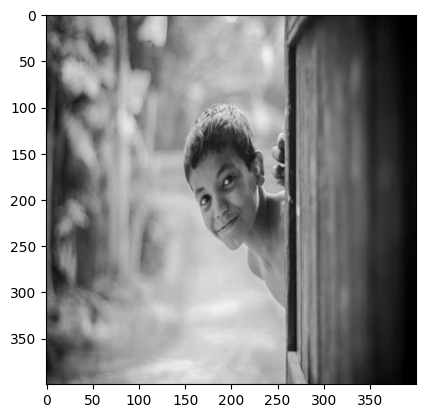

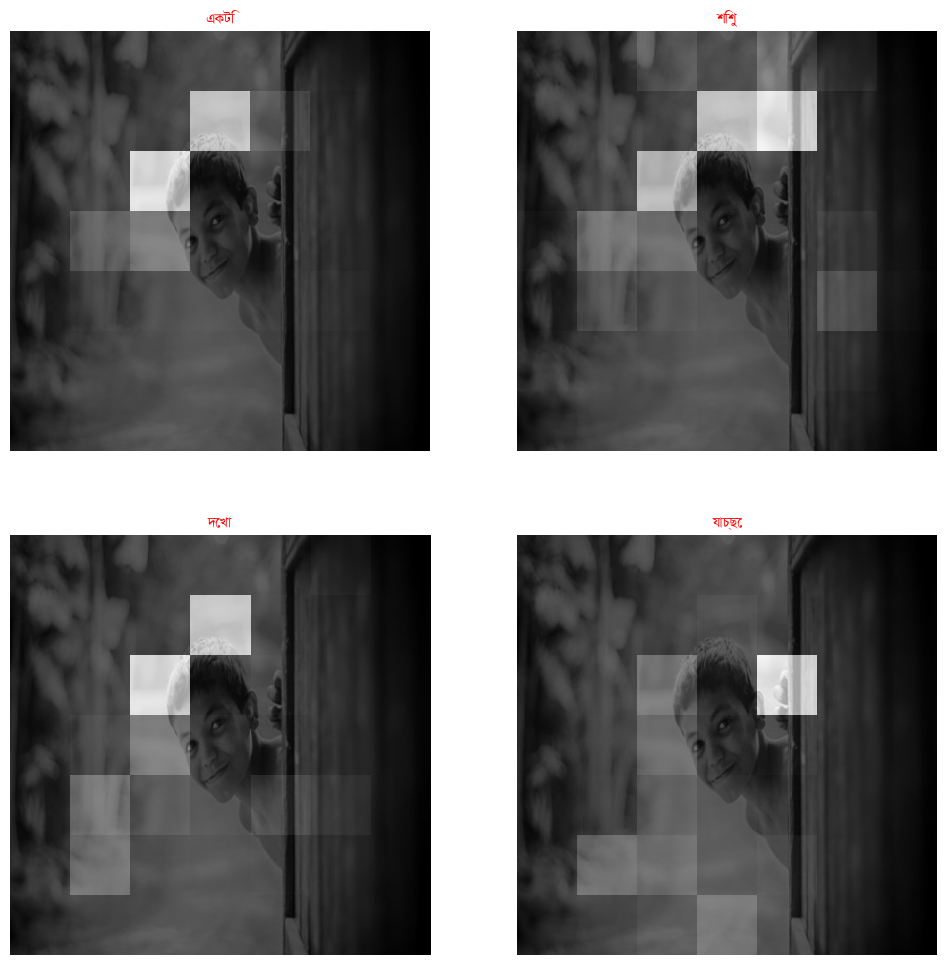

In [ ]:
cap_test_data = test_caption.copy()
rid = np.random.randint(0, len(test_data))
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['কয়েকটি বানর দেখা যাচ্ছে', 'খাঁচার ভিতর কয়েকটি বানর রয়েছে', 'একটি বন্দী কক্ষে কয়েকটি বানর দেখা যাচ্ছে', 'চিড়িয়াখানার কয়েকটি বানর দেখা যাচ্ছে', 'চিড়িয়াখানার খাঁচার ভিতর কয়েকটি বানর দেখা যাচ্ছে']
Prediction Caption: দুটি বানর রয়েছে
BLEU-1: 47.768754
BLEU-2: 41.368955
BLEU-3: 22.024071
BLEU-4: 15.174682
Meteor Score: 0.390625


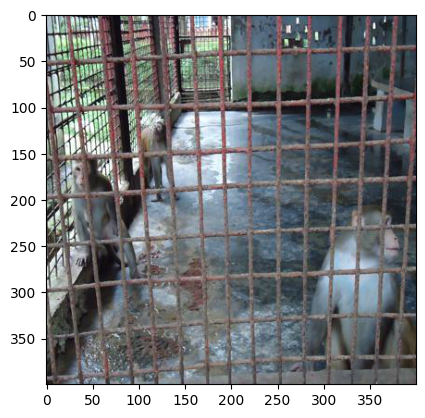

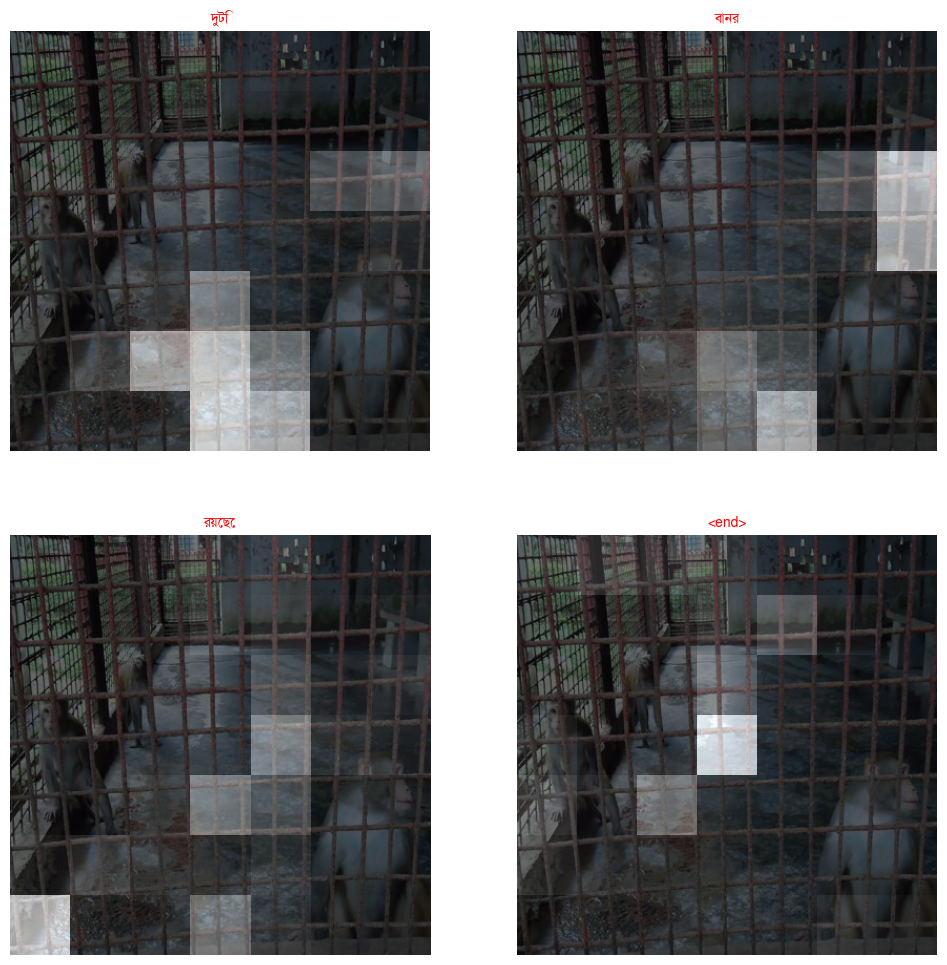

In [ ]:
cap_test_data = test_caption.copy()
rid = np.random.randint(0, len(test_data))
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি রাজপথের ছবি দেখা যাচ্ছে', 'রাজপথের পাশে নানা ধরনের গাড়ি দেখা যাচ্ছে', 'রাজপথের পাশে ট্যাক্সি দেখা যাচ্ছে', 'রাজপথের পাশে একটি বাস দেখা যাচ্ছে', 'রাজপাথের দুই পাশে আলোকিত গাছপালা দেখা যাচ্ছে']
Prediction Caption: একটি ট্রেন আর কিছু দালান দেখা যাচ্ছে
BLEU-1: 42.857143
BLEU-2: 26.726124
BLEU-3: 12.593147
BLEU-4: 9.068060
Meteor Score: 0.491453


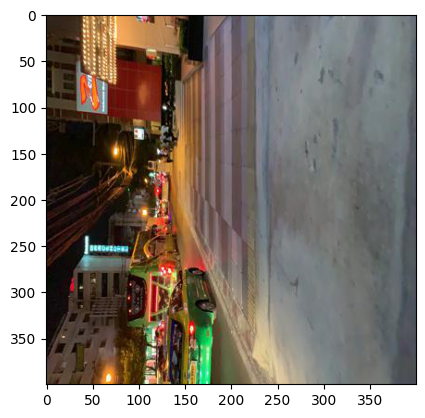

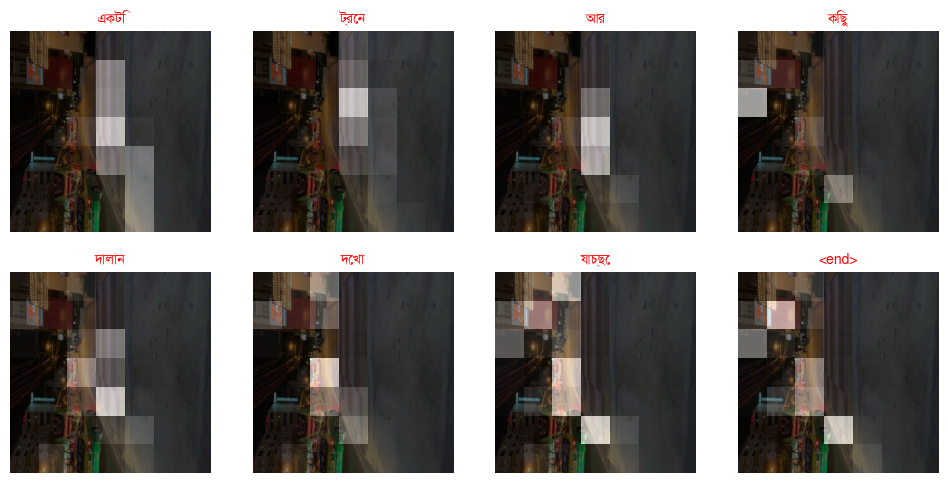

In [ ]:
cap_test_data = test_caption.copy()
rid = np.random.randint(0, len(test_data))
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['হাস্যজ্জল একটি মেয়ে', 'একটি মেয়ে দাঁড়িয়ে হাসছে', 'বিকেলের স্নিগ্ধ রোদে দাঁড়িয়ে থাকা একটি মেয়ে', 'হাস্যজ্জল মেয়ে দাঁড়িয়ে আছে', 'একটি মেয়ে সবুজ জামা পড়ে দাঁড়িয়ে আছে']
Prediction Caption: একটি মেয়ে মেয়েকে দেখা যাচ্ছে
BLEU-1: 40.000000
BLEU-2: 31.622777
BLEU-3: 15.846545
BLEU-4: 12.121094
Meteor Score: 0.585938


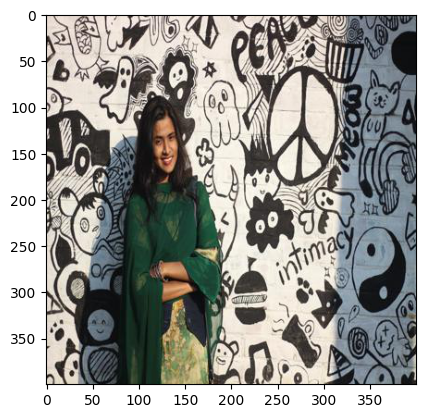

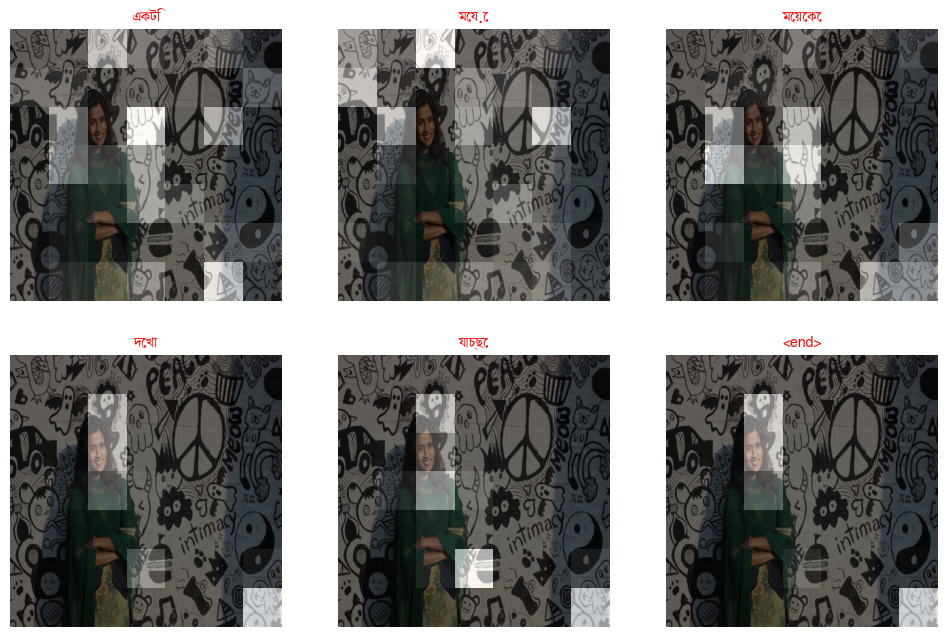

In [ ]:
cap_test_data = test_caption.copy()
rid = 100
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['কিছু গাছ দৃশ্যমান', 'একটি খেজুর গাছ দৃশ্যমান', 'একটি ছেলে দৃশ্যমান', 'একটি ছেলে গাছে উঠার চেষ্টা করছে', 'একটি পুকুর দৃশ্যমান']
Prediction Caption: একটি গ্রামের লাল ইটের ঘর দৃশ্যমান
BLEU-1: 33.333333
BLEU-2: 10.929347
BLEU-3: 5.689085
BLEU-4: 4.470634
Meteor Score: 0.303030


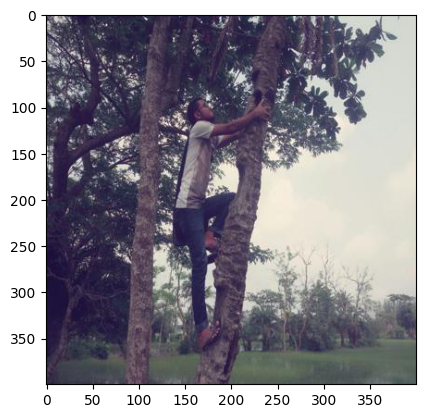

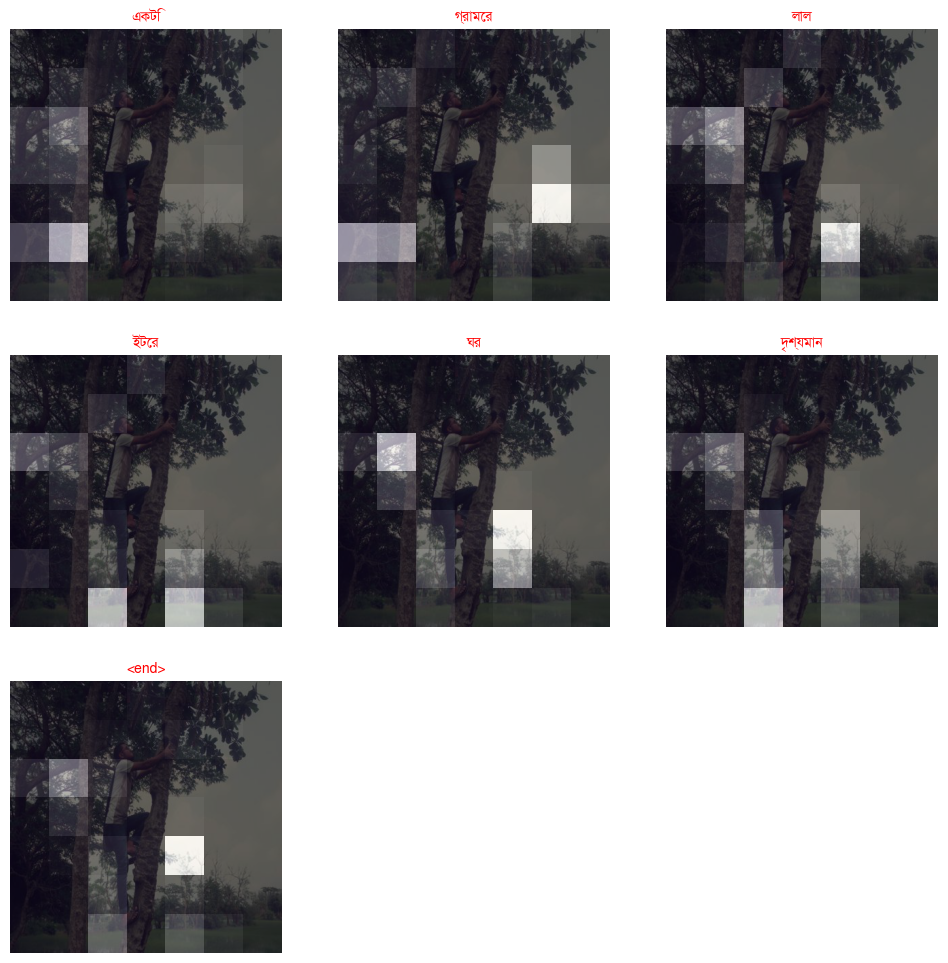

In [ ]:
cap_test_data = test_caption.copy()
rid = 435
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি বাটিতে খাবার আছে', 'একটি বাটিতে অনেক ধরনের খাবার আছে', 'প্যানকেক আছে', 'মাশরুম আছে', 'সসেজ আছে']
Prediction Caption: একটি করে সাজানো আছে
BLEU-1: 50.000000
BLEU-2: 15.200298
BLEU-3: 8.312788
BLEU-4: 7.258114
Meteor Score: 0.250000


ValueError: ignored

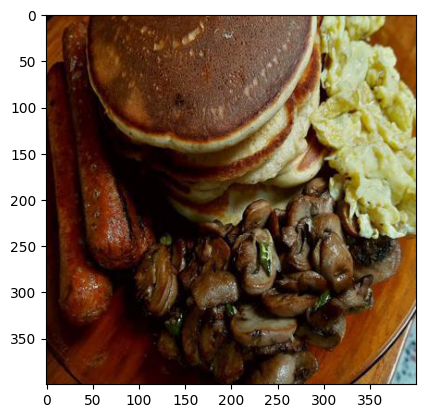

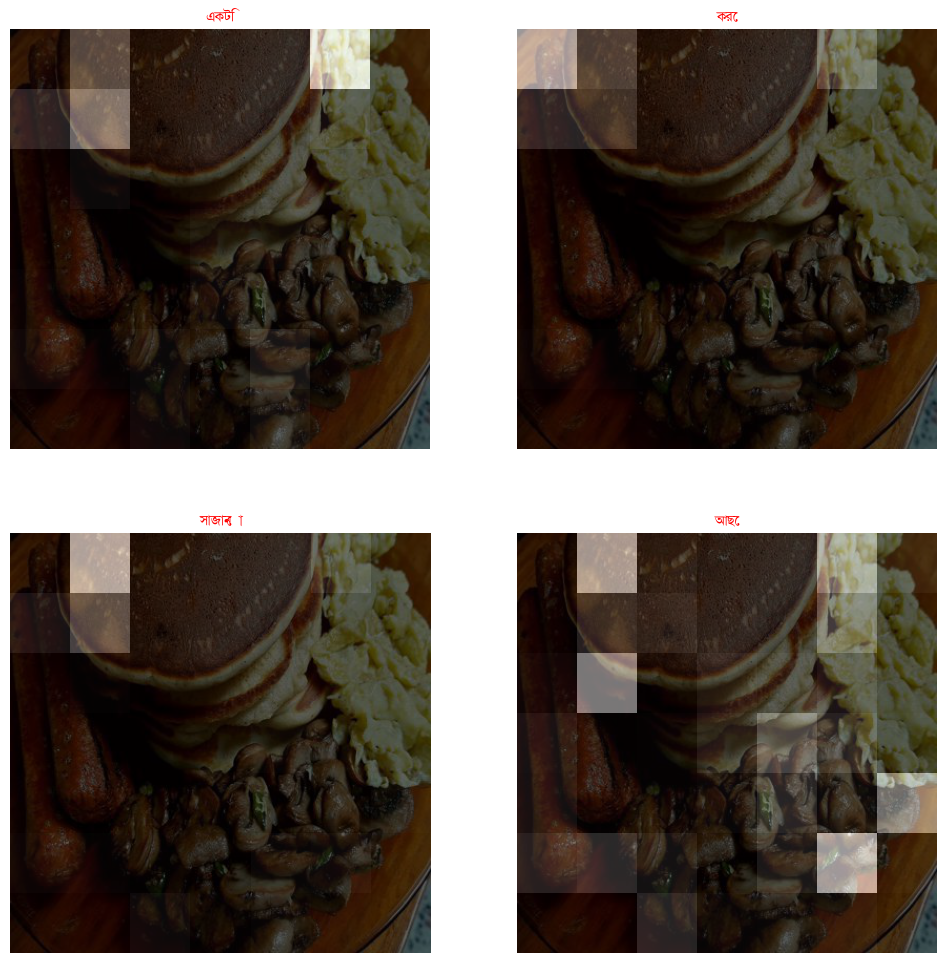

In [ ]:
cap_test_data = test_caption.copy()
rid = 311
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি পাহাড় আছে', 'অনেকগুলো গাছ আছে', 'একটি পাহাড়ে অনেক গাছ আছে', 'একটি গাছে অনেক শুকনো পাতা আছে', 'আকাশের নিচে একটি পাহাড় আছে']
Prediction Caption: একটি গাছ আছে
BLEU-1: 100.000000
BLEU-2: 70.710678
BLEU-3: 35.137637
BLEU-4: 23.437281
Meteor Score: 0.625000


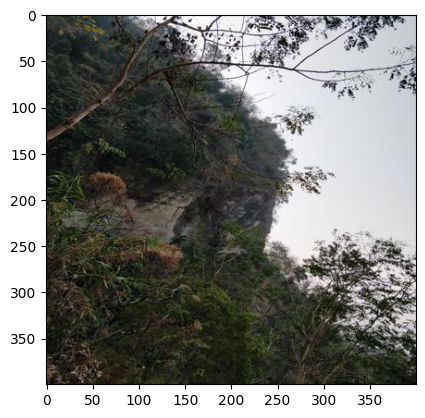

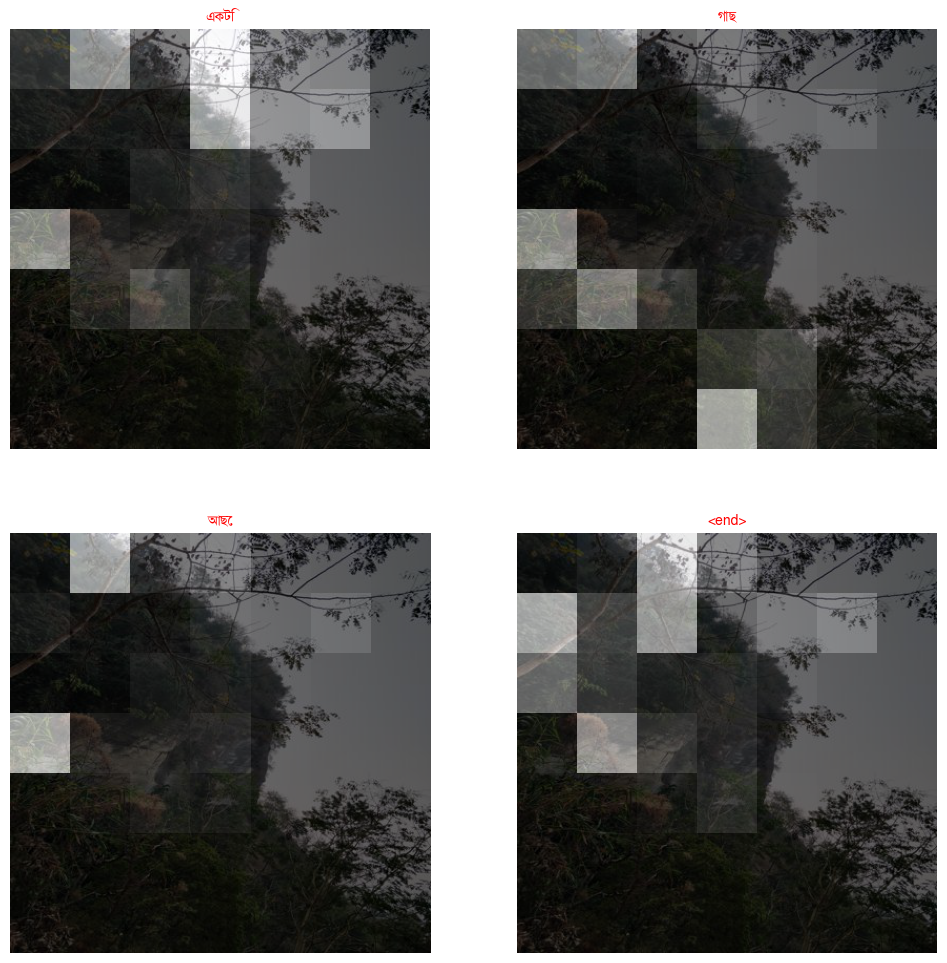

In [ ]:
cap_test_data = test_caption.copy()
rid = 161
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি বিড়াল দেখা যাচ্ছে', 'বিড়ালটি সাদা ও কামালা রঙের', 'বিড়ালটি সুয়ে আছে', 'দুটি বড়বড় কান দেখা যাচ্ছে', 'একটি মাঠ দেখা যাচ্ছে']
Prediction Caption: বিড়ালটির পিছে কিছু গাছ দেখা যাচ্ছে
BLEU-1: 33.333333
BLEU-2: 25.819889
BLEU-3: 12.967050
BLEU-4: 9.717717
Meteor Score: 0.446429


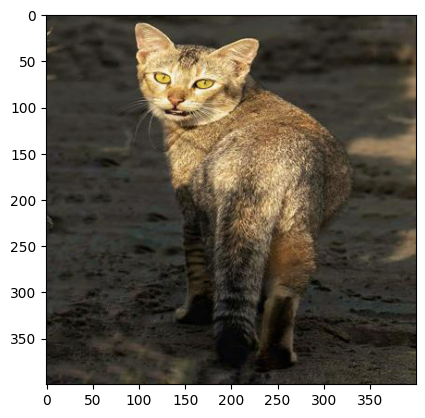

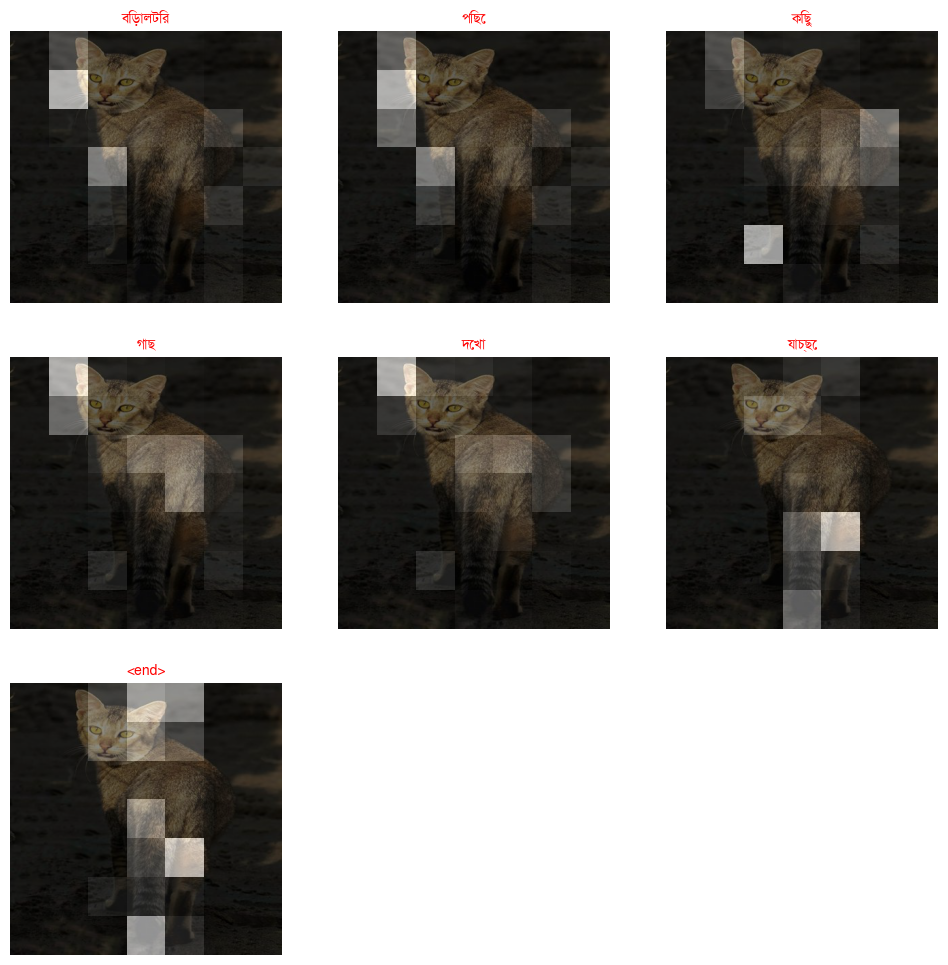

In [ ]:
cap_test_data = test_caption.copy()
rid = 235
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি কুকুর দেখা যাচ্ছে', 'একটি সাদা রঙের কুকুর দেখা যাচ্ছে', 'একটি সাদা কুকুরকে দেখা যাচ্ছে যেটি মাটিতে গড়াগড়ি খাচ্ছে', 'একটি সাদা কুকুর পোষ মানা অবস্থায় আছে', 'একটি কুকুর মাটিতে গড়াগড়ি খাওয়া অবস্থায় আছে']
Prediction Caption: একটি সাদা কুকুর আছে
BLEU-1: 100.000000
BLEU-2: 81.649658
BLEU-3: 67.687549
BLEU-4: 46.364283
Meteor Score: 0.559701


ValueError: ignored

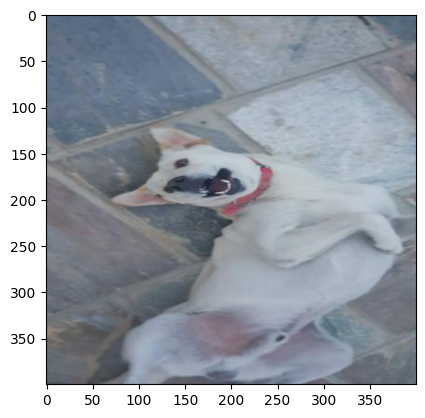

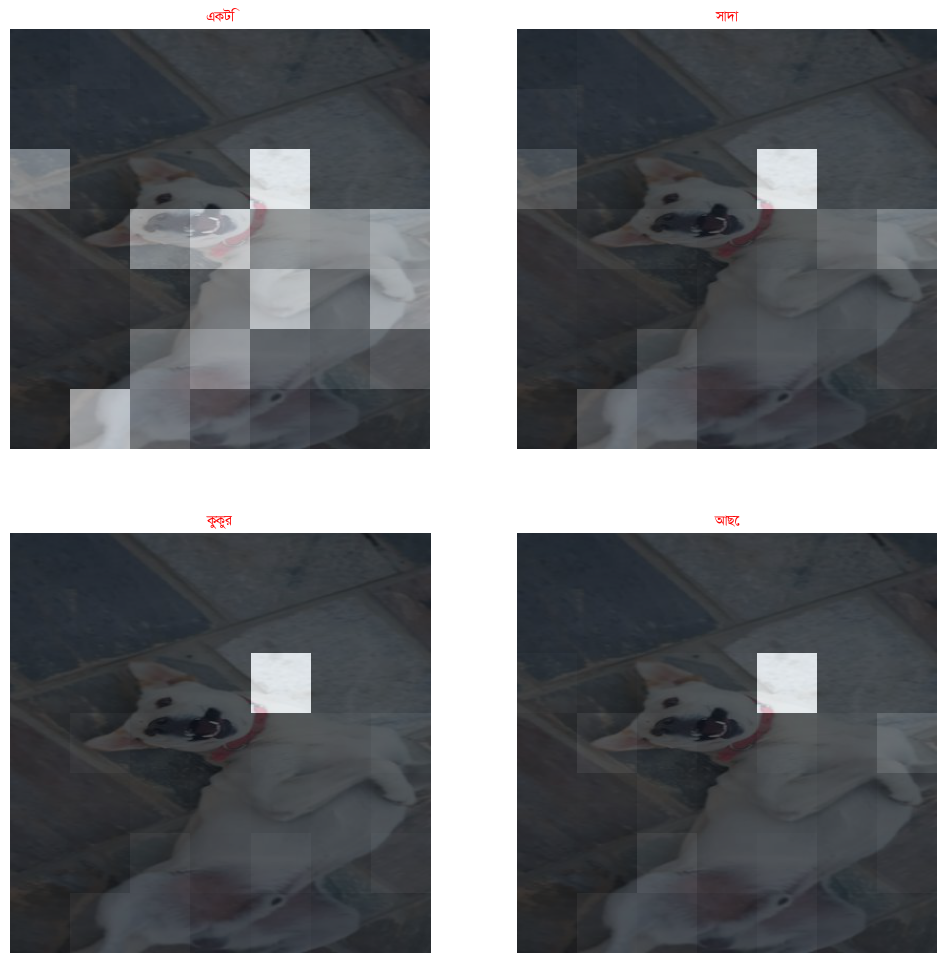

In [ ]:
cap_test_data = test_caption.copy()
rid = 700
test_image= test_data[rid]
real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

In [ ]:
b1=[]
b2=[]
b3=[]
b4=[]
m_score = []

for rid in range(0,len(test_data)):
  test_image= test_data[rid]
  real_caption = grouped_df.loc[grouped_df['filename'] == test_image, 'captions'].values[0]
  result, attention_plot, pred_test = evaluate(test_image)
  pred_caption=' '.join(result).rsplit(' ', 1)[0]
  reference = real_caption
  candidate = pred_caption.split()
  print(pred_caption)
  smooth = SmoothingFunction().method4
  bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
  bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
  bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
  bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
  b1.append(bleu1)
  b2.append(bleu2)
  b3.append(bleu3)
  b4.append(bleu4)
  score = meteor_score(reference,candidate)
  m_score.append(score)

মাছি ফুলের তোড়া হাতে একজন মহিলা বসে পানির পাশ সবুজ পানির ফোঁটা পানির পাশ বসে পানির পাশ সবুজ পানির ফোঁটা পানির পাশ
সরিষা ক্ষেতের ওপর মানুষ বসে আছে
একটি নীল রং এর সাথে চেয়ার এবং প্যাকেট এ হলুদ রঙের
একটি গাছ আছে
মেঘের আঁচল পার ধারণ করেছে
কিছু মানুষ দেখা যাচ্ছে
একটি উদ্ভিদের ছবি দেখা চোখওয়ালা চোখওয়ালা পাখি বসে খাচ্ছে
একটি বিড়াল আছে
একটি মেয়ে শাপলা গিরগিটি
ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট ছোট
একটি লোক বসে আছে
কনসার্টের রাস্তা দেখা যাচ্ছে
একটি লোক দেখা যাচ্ছে
একটি দারি গাছপালা দেখা যাচ্ছে
খাবার আছে
অনেক ঘাস রয়েছে
লোকটি নীল পানিতে গাছে
একটি ট্রেনের জানালা ধরে রেখেছে
একটি রাস্তা দেখা যাচ্ছে
মাংসের পাশে মাছ কুটছে
কয়েকটি গাছ আছে
সূর্যের আলো আকাশে সূর্যের হাত দিয়ে হেঁটে যাচ্ছে
একটি কালো পাখি রয়েছে
একটি বাবু বসে আছে
একজন লোক মাছ কাজ দুজন মানুষ মাছ নিয়ে একজন লোকের কাধে নৌকা চালাতে দেখা যাচ্ছে
সমুদ্রে একটি বোট দেখা যাচ্ছে
একটি প্রজাপতি বসে আছে
দূরে কিছু অগভীর কিন্তু নদীতে ভাসমান পুকুর ও দুইটি পুকুর ও দুইটি পুকুর ও দুইটি পুকুর ও দুইটি পুকুর ও দুইটি

KeyboardInterrupt: ignored

In [ ]:
print('BLEU-1: %f' % np.mean(b1))
print('BLEU-2: %f' % np.mean(b2))
print('BLEU-3: %f' % np.mean(b3))
print('BLEU-4: %f' % np.mean(b4))

In [ ]:
print('Meteor Score of Attention+BiGRU: %f' % np.mean(m_score))

## Zero shot with Banglalekha

In [ ]:
!wget https://data.mendeley.com/public-files/datasets/rxxch9vw59/files/220ffc5a-8645-4c0b-bd1b-97188836ed3b/file_downloaded

--2023-04-07 13:55:02--  https://data.mendeley.com/public-files/datasets/rxxch9vw59/files/220ffc5a-8645-4c0b-bd1b-97188836ed3b/file_downloaded
Resolving data.mendeley.com (data.mendeley.com)... 162.159.130.86, 162.159.133.86
Connecting to data.mendeley.com (data.mendeley.com)|162.159.130.86|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com/6312cfc2-6930-4530-9589-105499b29d5e [following]
--2023-04-07 13:55:03--  https://prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com/6312cfc2-6930-4530-9589-105499b29d5e
Resolving prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com (prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com)... 52.218.100.232, 52.218.41.72, 52.92.32.250, ...
Connecting to prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com (prod-dcd-datasets-public-files-eu-west-1.s3.eu-west-1.amazonaws.com)|52.218.100.232|

In [ ]:
import zipfile
exfile= '/content/file_downloaded'
zip_ref = zipfile.ZipFile(exfile, 'r')
zip_ref.extractall()
zip_ref.close()

In [ ]:
from os import listdir

image_dir = '/content/images'
images = listdir(image_dir)

In [ ]:
train_captions_bangla = load(open('/content/drive/MyDrive/Image Caption Generation /BanglaLekha/banglalekhal_captions.pkl', 'rb'))
img_name_vector_bangla = load(open('/content/drive/MyDrive/Image Caption Generation /BanglaLekha/banglalekhal_img_names.pkl', 'rb'))

In [ ]:
df_bangla = pd.DataFrame(list(zip(img_name_vector_bangla, train_captions_bangla)),
               columns =['filename_bangla', 'captions_bangla'])
df_bangla.head(10)

,filename_bangla,captions_bangla
0,/content/images/1.png,<start> তিন জন মেয়ে মানুষ আছে এক জন দাড়িয়ে আছ...
1,/content/images/2.png,<start> অনেক মেয়ে মানুষ বসে আছে <end>
2,/content/images/3.png,<start> অনেক মানুষ একসাথে বসে কাজ করছে <end>
3,/content/images/4.png,<start> ছয় জন মানুষ দাড়িয়ে আছে <end>
4,/content/images/5.png,<start> এক জন মেয়ে মানুষ মাথায় ঘোমটা দিয়ে কাজ ...
5,/content/images/6.png,<start> আবছা অন্ধকারে এক জন মানুষ দাড়িয়ে আছে ...
6,/content/images/7.png,<start> তিন জন মানুষ আছে এক জন মাথায় ছাতা ধরে...
7,/content/images/8.png,<start> খালি গায়ে একটি বাচ্চা ছাতার নিচে বসে ক...
8,/content/images/9.png,<start> একজন মেয়ে মানুষ শাড়ি পরে দাড়িয়ে আছে প...
9,/content/images/10.png,<start> একটি বাচ্চা মানুষ বসে কাজ করছে সে একট...


In [ ]:
grouped_bangla = df_bangla.groupby('filename_bangla')['captions_bangla'].apply(list).reset_index(name='captions_bangla')
grouped_bangla['captions_bangla'] = [[caption.split() for caption in captions] for captions in grouped_bangla['captions_bangla']]

In [ ]:
for i, row in grouped_bangla.iterrows():
    captions = row['captions_bangla']
    captions = [caption[1:-1] for caption in captions]
    grouped_bangla.at[i, 'captions_bangla'] = captions

In [ ]:
grouped_bangla['captions_bangla'][4]

[['একজন', 'নারী', 'দুইজন', 'বালিকা', 'ও', 'দুইজন', 'পুরুষ', 'দাড়িয়ে', 'আছে'],
 ['৩',
  'জন',
  'মেয়ে',
  'ও',
  '১',
  'জন',
  'পুরুষের',
  'হাতে',
  'মাশরুম',
  'আর',
  'পাশে',
  'একজন',
  'পুরুষ',
  'মানুষ']]

In [ ]:
train_data_bangla, test_data_bangla, train_caption_bangla, test_caption_bangla = train_test_split(img_name_vector_bangla, train_captions_bangla, test_size = 0.1, random_state = 42)

Real Caption: ['একটি নৌকায় মানুষ আছে পানিতে দুইজন মানুষ আছে', 'নদীর পানিতে চলে যাচ্ছে একটি নৌকা এবং ২ জন পুরুষ হালকা পানি দিয়ে হেটে যাচ্ছে']
Prediction Caption: একজন মানুষ দাড়িয়ে একজন দেখছে
BLEU-1: 10.976233
BLEU-2: 4.923177
BLEU-3: 2.929810
BLEU-4: 2.505308
Meteor Score: 0.064935


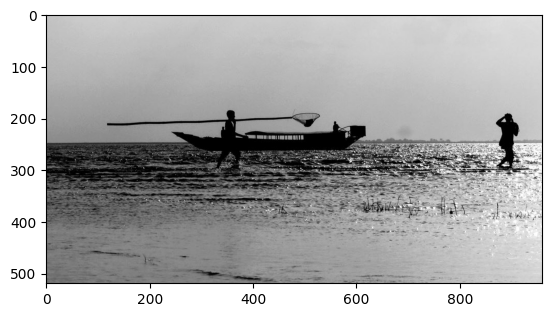

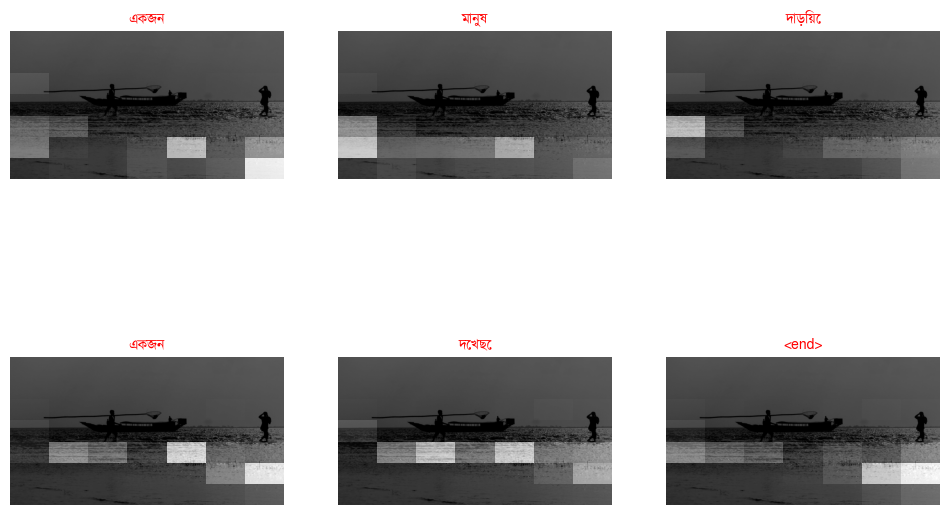

In [ ]:
cap_test_data = test_caption_bangla.copy()
rid = 100
test_image= test_data_bangla[rid]
real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একজন পুরুষ ক্যামেরা দিয়ে ছবি তুলছে', 'একটি লোক ক্যামেরা দিয়ে ছবি তুলছে']
Prediction Caption: মানুষের মধ্যে কয়েকজন মানুষ দাঁড়িয়ে আছে
BLEU-1: 0.000000
BLEU-2: 0.000000
BLEU-3: 0.000000
BLEU-4: 0.000000
Meteor Score: 0.000000


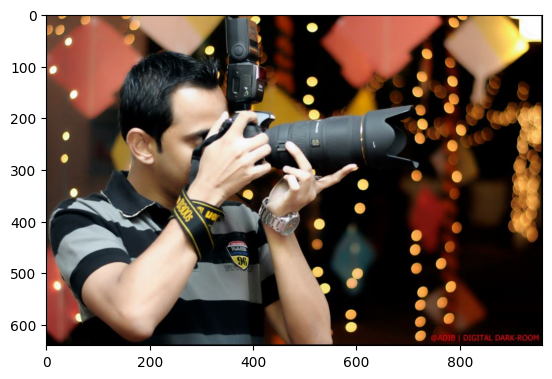

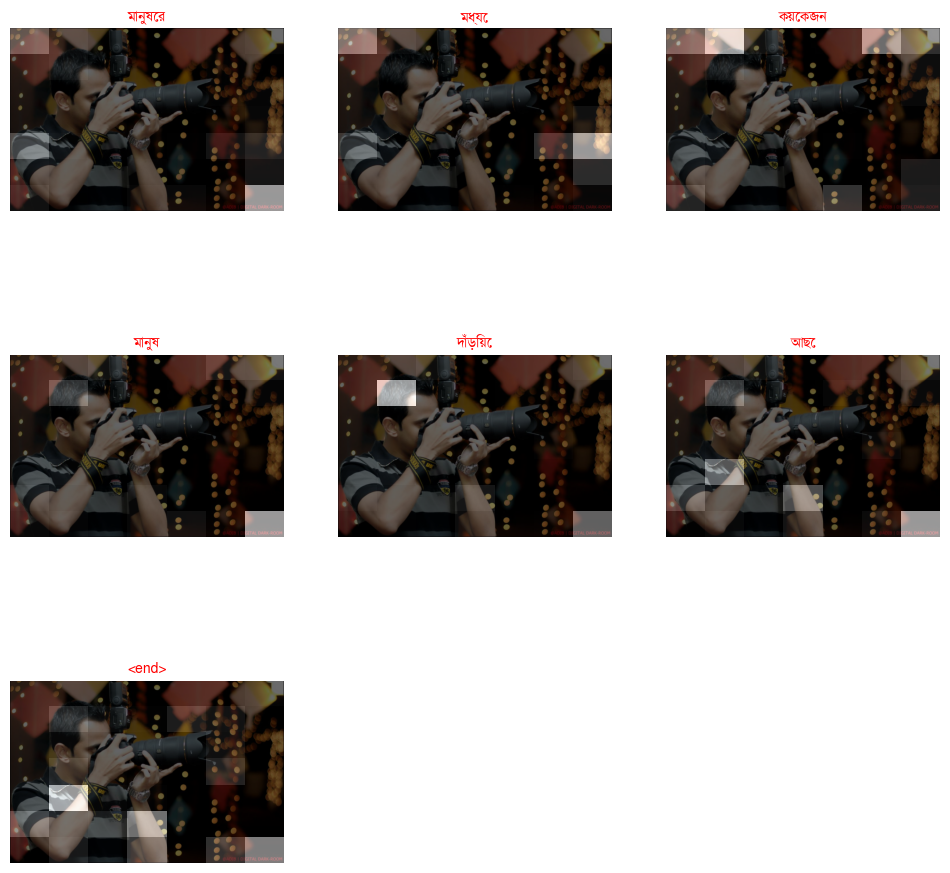

In [ ]:
cap_test_data = test_caption_bangla.copy()
rid = 435
test_image= test_data_bangla[rid]
real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['কয়েকজন মানুষ দাড়িয়ে আছে', 'কয়েকজন ছোট ছেলে মেয়েকে পড়াশুনা করাচ্ছে']
Prediction Caption: কিছু ণৌযান দেখা যাচ্ছে
BLEU-1: 0.000000
BLEU-2: 0.000000
BLEU-3: 0.000000
BLEU-4: 0.000000
Meteor Score: 0.000000


ValueError: ignored

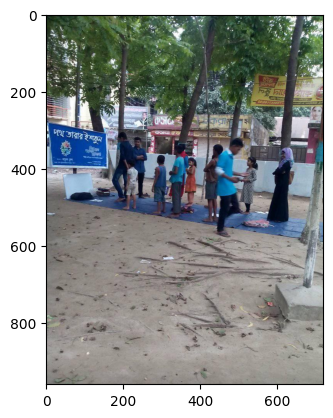

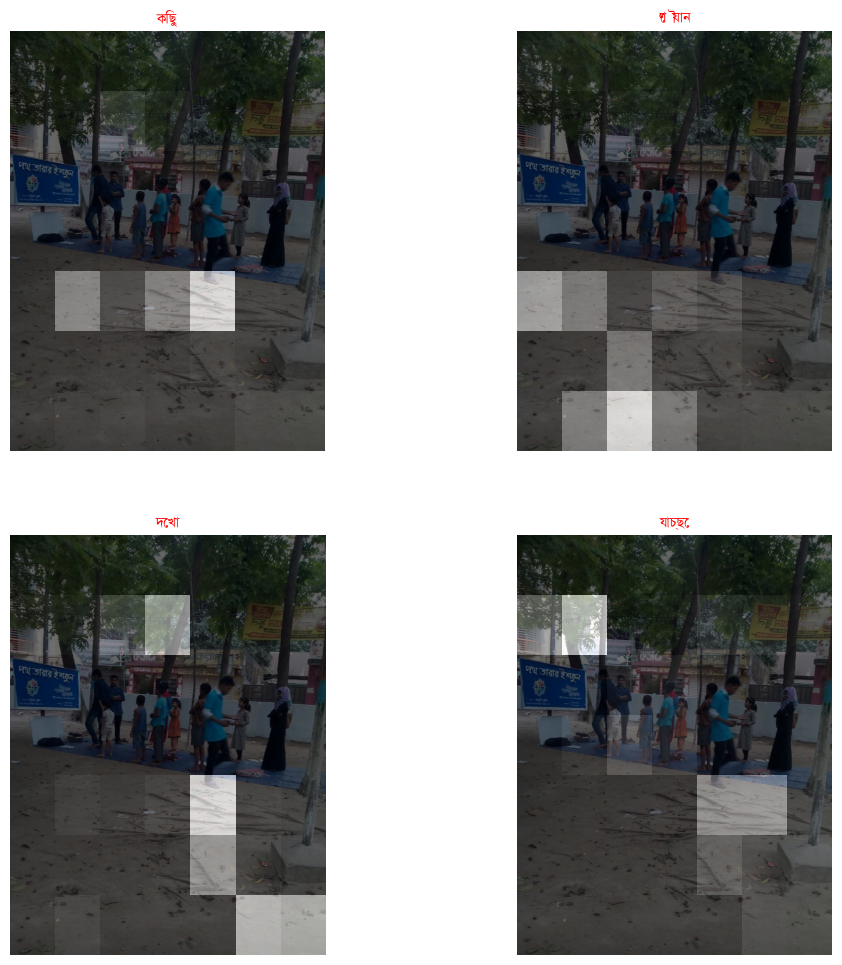

In [ ]:
cap_test_data = test_caption_bangla.copy()
rid = 311
test_image= test_data_bangla[rid]
real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['দুইজন মানুষ সাইকেল চালাচ্ছে', 'দুইজন ছেলে দুইটা সাইকেল চালিয়ে রাস্তা দিয়ে যাচ্ছে']
Prediction Caption: আকাশে সূর্যের রশ্মি দেখা যাচ্ছে
BLEU-1: 20.000000
BLEU-2: 8.970613
BLEU-3: 5.338461
BLEU-4: 4.564969
Meteor Score: 0.064935


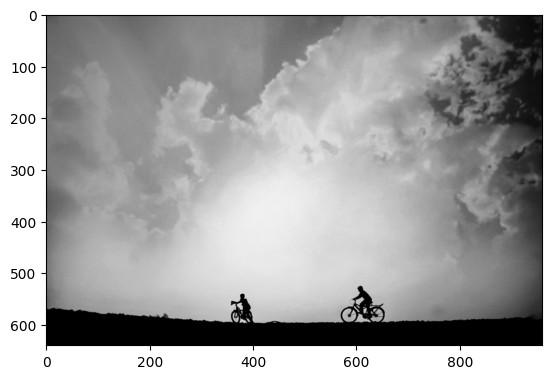

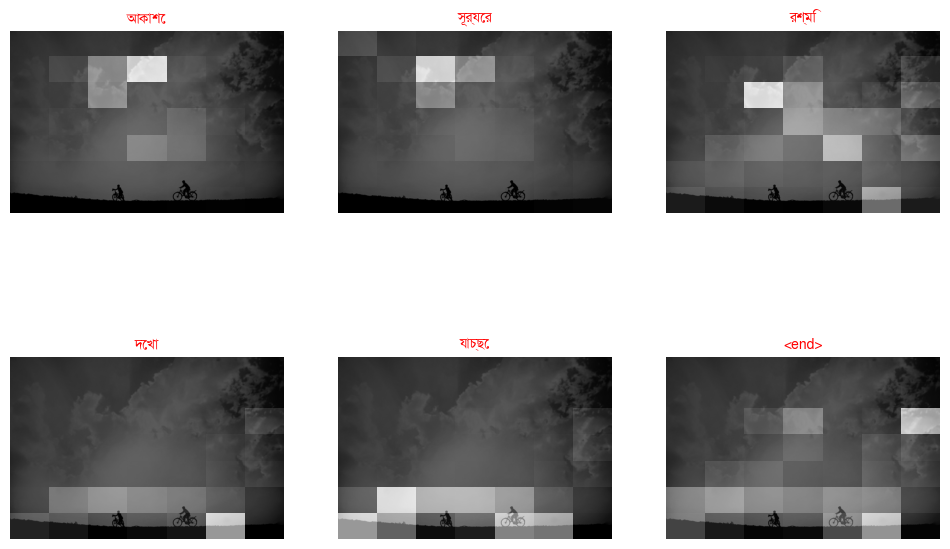

In [ ]:
cap_test_data = test_caption_bangla.copy()
rid = 161
test_image= test_data_bangla[rid]
real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['কয়েকটি বই আছে', 'অনেকগুলো কোরআন একসাথে সাজিয়ে রয়েছে']
Prediction Caption: পিজ্জার পাশে একটি ছোট পাতা দেখা যাচ্ছে
BLEU-1: 0.000000
BLEU-2: 0.000000
BLEU-3: 0.000000
BLEU-4: 0.000000
Meteor Score: 0.000000


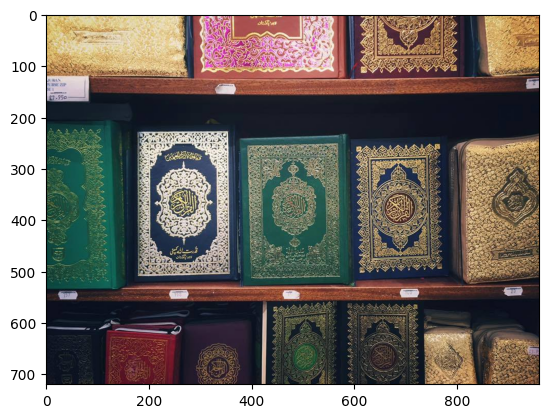

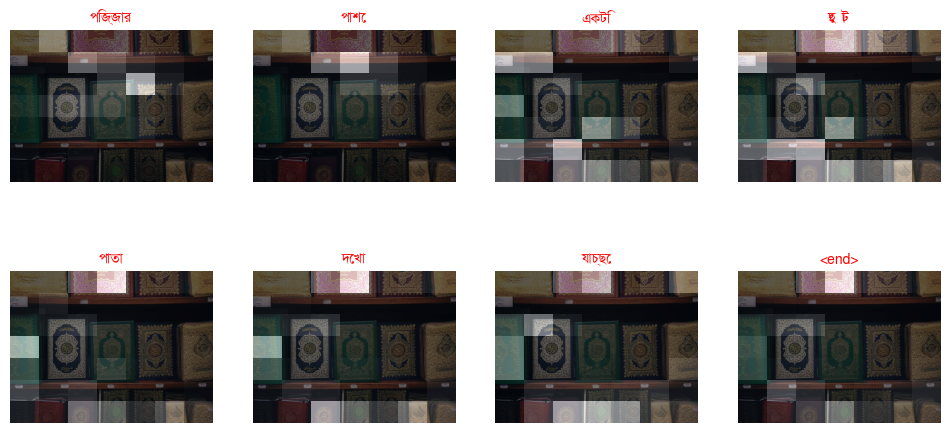

In [ ]:
cap_test_data = test_caption_bangla.copy()
rid = 235
test_image= test_data_bangla[rid]
real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

In [ ]:
cap_test_data = test_caption_bangla.copy()
rid = 100
test_image= test_data_bangla[rid]
real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একজন পুরুষ একটি নৌকা চালাচ্ছে', 'চারদিকে কাশফুলের বাগান আর নদীতে মাঝি একটা নৌকা বাইচে']
Prediction Caption: একটি নৌকা রয়েছে
BLEU-1: 34.227808
BLEU-2: 29.642151
BLEU-3: 15.780937
BLEU-4: 10.873134
Meteor Score: 0.390625


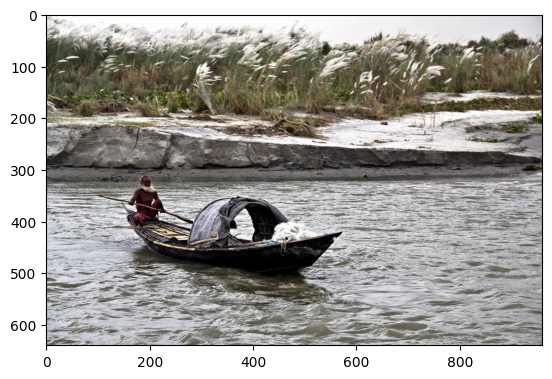

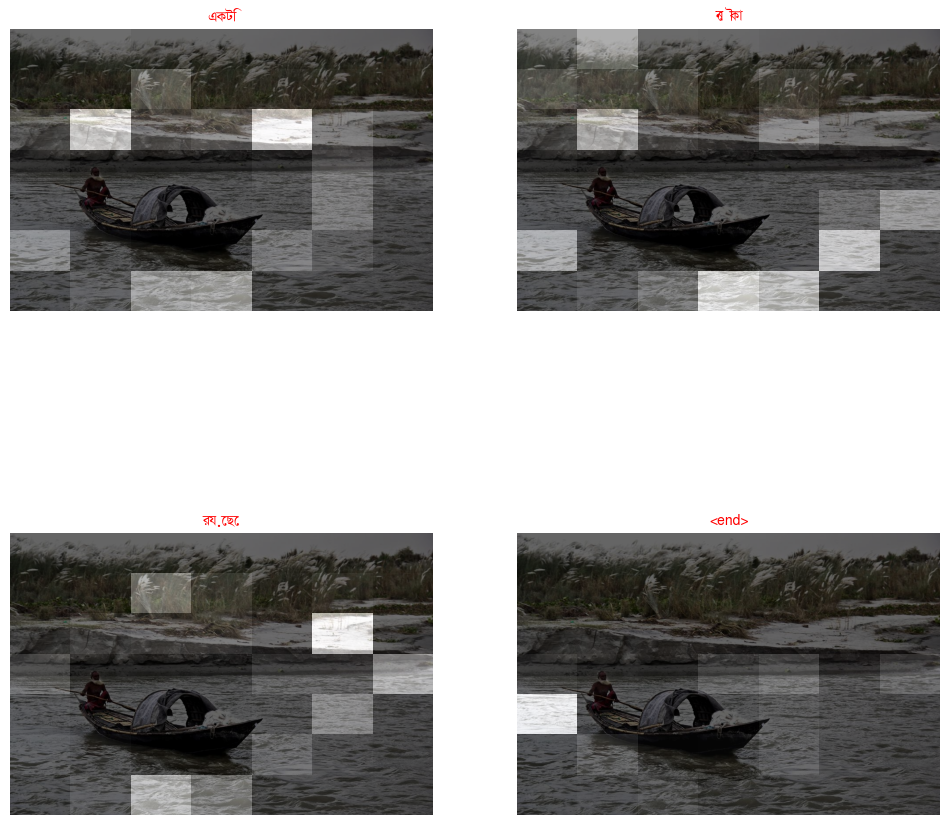

In [ ]:
cap_test_data = test_caption_bangla.copy()
rid = 700
test_image= test_data_bangla[rid]
real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

In [ ]:
b1_bangla=[]
b2_bangla=[]
b3_bangla=[]
b4_bangla=[]
m_score_bangla = []

for rid in range(0,len(test_data_bangla)):
  test_image= test_data_bangla[rid]
  real_caption = grouped_bangla.loc[grouped_bangla['filename_bangla'] == test_image, 'captions_bangla'].values[0]
  result, attention_plot, pred_test = evaluate(test_image)
  pred_caption=' '.join(result).rsplit(' ', 1)[0]
  reference = real_caption
  candidate = pred_caption.split()
  print(pred_caption)
  smooth = SmoothingFunction().method4
  bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
  bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
  bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
  bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
  b1_bangla.append(bleu1)
  b2_bangla.append(bleu2)
  b3_bangla.append(bleu3)
  b4_bangla.append(bleu4)
  score = meteor_score(reference,candidate)
  m_score_bangla.append(score)

সবুজ গাছপালা আছে
একটি সসের মানচিত্র
নদী দেখা যাচ্ছে
একজন বালক
পানিতে অনেক গাছপালা রয়েছে
একজন লোক বাচ্চা দুটী গাছ আছে
লাল ইটের রাস্তা দেখা যাচ্ছে
একটি নীল নীল নীল প্যান্ট আছে
একটি বালক নীল জামা পরে কমরে হাত দিয়ে হয়
একটি সরু একটি সরু একটি সাইকেল চালাতে দেখা যাচ্ছে
সমুদ্রে একটি লঞ্চ দেখা যাচ্ছে
একজন লোকের দুটি বেলুন
একজন ব্যাক্তি তাকিয়ে আছে
একটি মহিলার ছবি দেখা যাচ্ছে
একজন লোক বসে আছে
দুটি শিশু সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত সরিষা ক্ষেত
একটি রেললাইন রয়েছে
একটি ফসলি গাছ পালা দেখা যাচ্ছে
একটি স্তুপ কথা বলছে
নদীর উপর একটি নৌকা আছে
একজন মানুষ
মঞ্চে সিড়িতে নিজের মনোযোগ দিয়ে একজন ব্যক্তি ভাষণ দিতে দেখা যাচ্ছে
একটি শিশু দেখা যাচ্ছে
একটি পালতোলা নৌকা দেখা যাচ্ছে
একটি বালক জানালার সামনে দুইটি ব্যাগ ধরে আছে
একটি ইটের দরজার সামনে ইটের সিঁড়ি
আকাশে কিছু নৌকা আছে
ফুল গাছে আলো পড়েছে
দূরে পাহাড় দেখা যাচ্ছে
একটি কালো রঙের দালান রয়েছে
একজন লোক বসে আছে
দুজন ব্যক্তি কাজ করছেন
একটি জলাশয় আছে
জানালা দিয়ে দোকানের পেছনে ইটের জানালা দিয়ে

In [ ]:
# zero shot with banglalekha
print('BLEU-1: %f' % np.mean(b1_bangla))
print('BLEU-2: %f' % np.mean(b2_bangla))
print('BLEU-3: %f' % np.mean(b3_bangla))
print('BLEU-4: %f' % np.mean(b4_bangla))

BLEU-1: 14.944926
BLEU-2: 7.013730
BLEU-3: 3.946144
BLEU-4: 3.186355


In [ ]:
print('Meteor Score zero short banglalekha : %f' % np.mean(m_score_bangla))

Meteor Score zero short banglalekha : 0.086449


## Zero shot with Bancap


In [ ]:
!wget -q https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip

!unzip -qq Flickr8k_Dataset.zip

In [ ]:
from os import listdir
## The location of the Flickr8K_ photos
image_dir = '/content/Flicker8k_Dataset'
images_bancap = listdir(image_dir)
print(len(images_bancap))

8091


In [ ]:
total_captions_bancap = load(open('/content/drive/MyDrive/Image Caption Generation /Bancap/bancap_captions.pkl', 'rb'))
img_name_vector_bancap = load(open('/content/drive/MyDrive/Image Caption Generation /Bancap/bancap_img_names.pkl', 'rb'))

In [ ]:
bancap_df = pd.DataFrame(list(zip(img_name_vector_bancap, total_captions_bancap)),
               columns =['filename_bancap', 'captions_bancap'])
bancap_df.head(10)

,filename_bancap,captions_bancap
0,/content/Flicker8k_Dataset/1000268201_693b08cb...,<start> একটি গোলাপী জামা পরা বাচ্চা মেয়ে একটি ...
1,/content/Flicker8k_Dataset/1000268201_693b08cb...,<start> একটি মেয়ে শিশু একটি কাঠের বাড়িতে ঢুকছে...
2,/content/Flicker8k_Dataset/1000268201_693b08cb...,<start> একটি বাচ্চা তার কাঠের খেলাঘরে উঠছে <...
3,/content/Flicker8k_Dataset/1000268201_693b08cb...,<start> ছোট মেয়েটি তার খেলার ঘরের সিড়ি বেয়ে উঠ...
4,/content/Flicker8k_Dataset/1000268201_693b08cb...,<start> গোলাপি জামা পড়া ছোট একটি মেয়ে একটি কা...
5,/content/Flicker8k_Dataset/1001773457_577c3a7d...,<start> একটি কালো কুকুর এবং একটি ছোপওয়ালা কুকু...
6,/content/Flicker8k_Dataset/1001773457_577c3a7d...,<start> একটি কালো কুকুর একটি তিন রঙা কুকুরের স...
7,/content/Flicker8k_Dataset/1001773457_577c3a7d...,<start> একটি কালো কুকুর ও একটি সাদা বাদামি ছোপ...
8,/content/Flicker8k_Dataset/1001773457_577c3a7d...,<start> ভিন্ন জাতের দুটি কুকুর রাস্তায় একে অপ...
9,/content/Flicker8k_Dataset/1001773457_577c3a7d...,<start> রাস্তার পাশে দুইটি কুকুর পরস্পরের দিকে...


In [ ]:
grouped_bancap = bancap_df.groupby('filename_bancap')['captions_bancap'].apply(list).reset_index(name='captions_bancap')
grouped_bancap['captions_bancap'] = [[caption.split() for caption in captions] for captions in grouped_bancap['captions_bancap']]

In [ ]:
grouped_bancap['captions_bancap'][0]

[['<start>',
  'একটি',
  'গোলাপী',
  'জামা',
  'পরা',
  'বাচ্চা',
  'মেয়ে',
  'একটি',
  'বাড়ির',
  'প্রবেশ',
  'পথের',
  'সিঁড়ি',
  'বেয়ে',
  'উঠছে',
  '<end>'],
 ['<start>',
  'একটি',
  'মেয়ে',
  'শিশু',
  'একটি',
  'কাঠের',
  'বাড়িতে',
  'ঢুকছে',
  '<end>'],
 ['<start>', 'একটি', 'বাচ্চা', 'তার', 'কাঠের', 'খেলাঘরে', 'উঠছে', '<end>'],
 ['<start>',
  'ছোট',
  'মেয়েটি',
  'তার',
  'খেলার',
  'ঘরের',
  'সিড়ি',
  'বেয়ে',
  'উঠছে',
  '<end>'],
 ['<start>',
  'গোলাপি',
  'জামা',
  'পড়া',
  'ছোট',
  'একটি',
  'মেয়ে',
  'একটি',
  'কাঠের',
  'তৈরি',
  'ঘরে',
  'প্রবেশ',
  'করছে',
  '<end>']]

In [ ]:
for i, row in grouped_bancap.iterrows():
    captions = row['captions_bancap']
    captions = [caption[1:-1] for caption in captions]
    grouped_bancap.at[i, 'captions_bancap'] = captions

In [ ]:
grouped_bancap['captions_bancap'][4]

[['কমলা',
  'টুপি',
  'পরিহিত',
  'একজন',
  'পুরুষ',
  'কোনোকিছুর',
  'দিকে',
  'তাকিয়ে',
  'আছে'],
 ['একজন', 'মানুষ', 'কমলা', 'রঙের', 'টুপি', 'পরেছ', 'এবং', 'চশমাও', 'পরেছে'],
 ['চশমাযুক্ত', 'একজন', 'ব্যক্তি', 'একটি', 'ব্লিটজ', 'টুপি', 'পরেছেন'],
 ['চশমা',
  'পরিহিত',
  'একজন',
  'ব্যক্তি',
  'বিয়ারের',
  'কৌটা',
  'দিয়ে',
  'বানানো',
  'টুপি',
  'পরে',
  'আছে'],
 ['কান', 'ফোঁড়ানো', 'ব্যক্তিটি', 'চশমা', 'এবং', 'কমলা', 'টুপি', 'পরেছে']]

In [ ]:
train_data_bancap, test_data_bancap, train_caption_bancap, test_caption_bancap = train_test_split(img_name_vector_bancap, total_captions_bancap, test_size = 0.1, random_state = 42)

In [ ]:
len(test_data_bancap)

4000

Real Caption: ['একটি কালো কুকুর ক্যামেরার দিকে দৌড়াচ্ছে', 'একটি কালো কুকুর ঘাসের উপর দোড়াচ্ছে', 'একটি কালো কুকুর একটি বাদামী এবং সাদা কুকুরের কাছাকাছি ঘাসের উপর ছুটে চলেছে', 'শুকনো ঘাসের মধ্যে দিয়ে একটি কালো কুকুর দৌড়ে যায়', 'একটি কুকুর ক্যামেরার দিকে এগিয়ে আসছে আর একটি পিছনে হেঁটে যাচ্ছে']
Prediction Caption: একটি কালো গরু রয়েছে
BLEU-1: 30.326533
BLEU-2: 24.761510
BLEU-3: 12.507435
BLEU-4: 10.202995
Meteor Score: 0.323276


ValueError: ignored

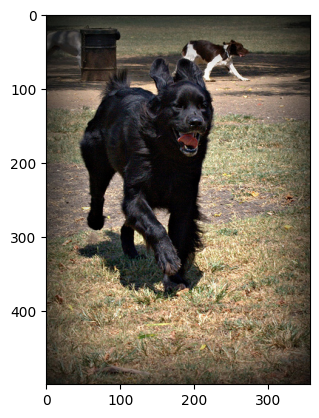

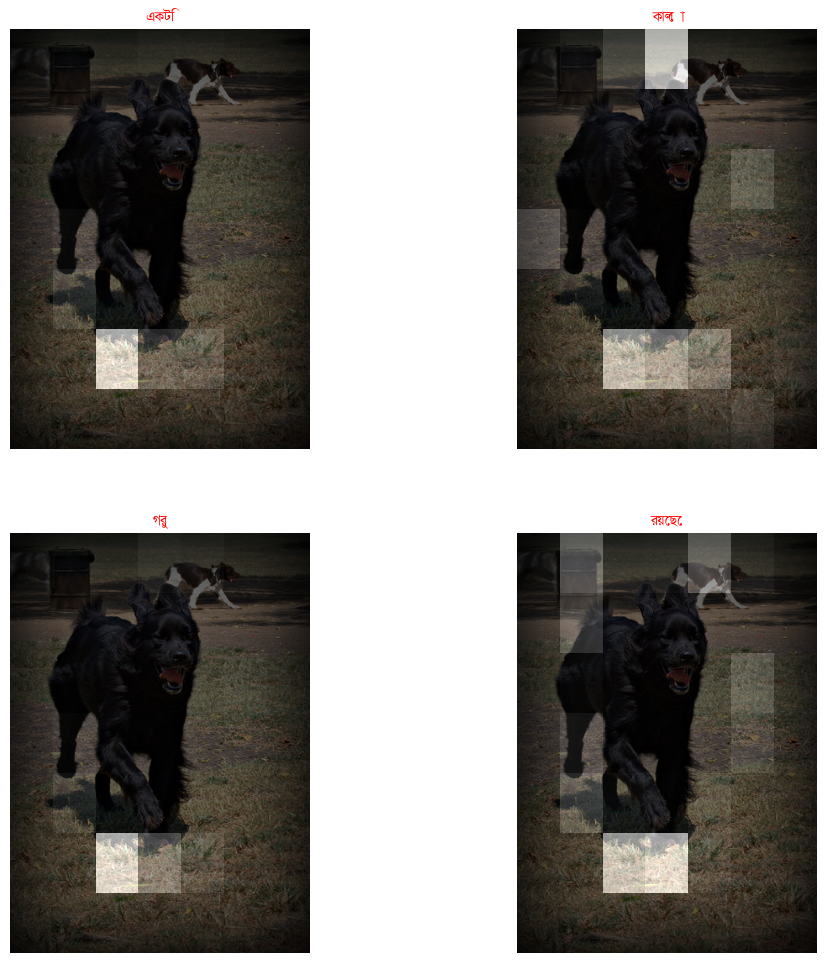

In [ ]:
cap_test_data = test_caption_bancap.copy()
rid = 100
test_image= test_data_bancap[rid]
real_caption = grouped_bancap.loc[grouped_bancap['filename_bancap'] == test_image, 'captions_bancap'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি ব্রিন্ডল লেপযুক্ত কুকুর একটি পার্কের ঘেরের অভ্যন্তরে বেগুনি রঙের কলারযুক্ত একটি জাম্পিং ব্রাউন কুকুরের দিকে ঘেউ ঘেউ করছে', 'দুটি কুকুর খেলছে একজন লোক তা দেখছে', 'খেলা করা দুটি কুকুরের সাথে একজন লোক দাঁড়িয়ে আছেন', 'একটি লোক একটি খেঁকী বাদামী ও কালো কুকুর এবং একটি দাঁড়ানো হালকা বাদামী কুকুরের পাশে দাঁড়িয়ে আছে', 'দুটি কুকুর একটি বাদামী এবং একটি ধুসর বর্ণের জিন্স পরা এক ব্যাক্তির পায়ের পাশে খেলছে']
Prediction Caption: একটি কুকুর দেখা যাচ্ছে
BLEU-1: 23.618328
BLEU-2: 7.180112
BLEU-3: 3.926683
BLEU-4: 3.428490
Meteor Score: 0.074627


ValueError: ignored

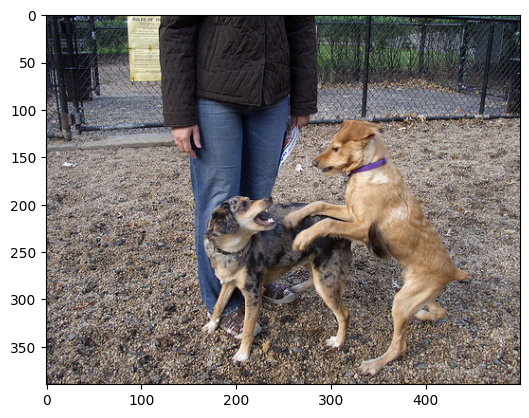

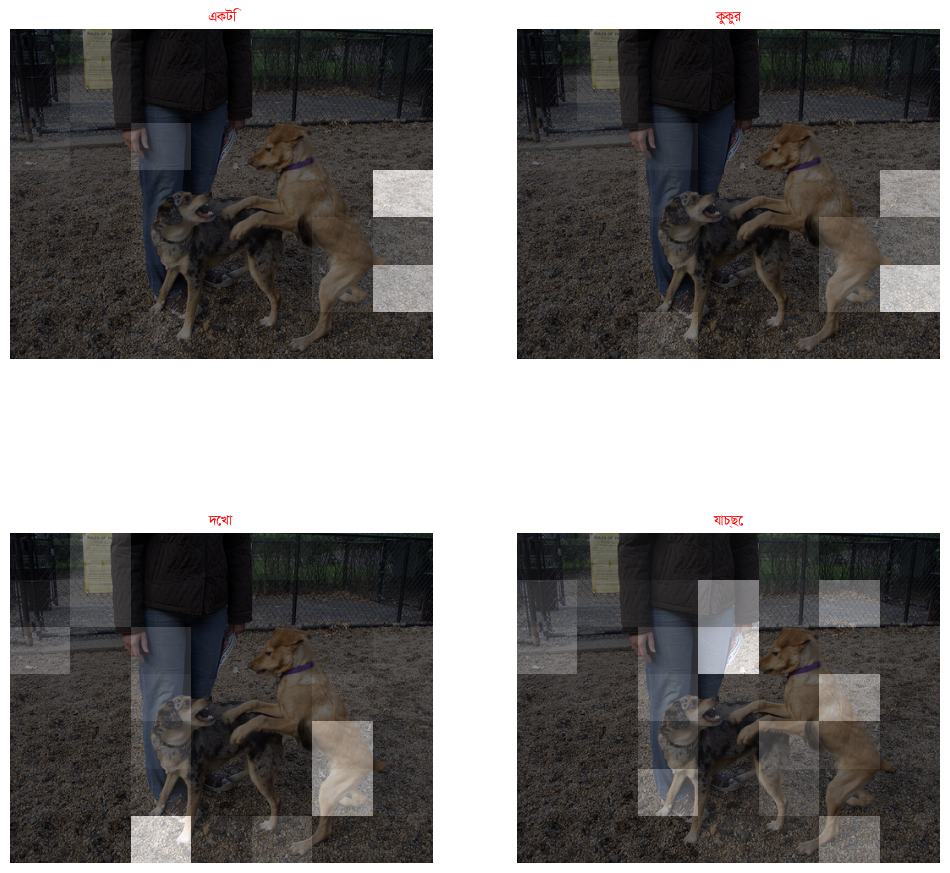

In [ ]:
cap_test_data = test_caption_bancap.copy()
rid = 1205
test_image= test_data_bancap[rid]
real_caption = grouped_bancap.loc[grouped_bancap['filename_bancap'] == test_image, 'captions_bancap'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি হকি খেলা হচ্ছে', 'দুজন মানুষ খেলার পোশাকে মাঠে দৌড়াচ্ছে', 'বেগুনি সাদা এবং কালো রঙের একটি খেলোয়াড় মাঠের শেষের কাছে একটি নাটক তৈরি করার চেষ্টা করে', 'পনেরো নম্বর জার্সি পরিহিত একজন খেলোয়াড় ল্যাক্রোস বল নিয়ে দৌড়াচ্ছে', 'দুজন লাক্রোসে খেলোয়াড় খেলার মাঠে দৌড়াচ্ছে']
Prediction Caption: তাদের পেছনে তাদের পেছনে তাদের পেছনে তাদের পেছনে তাদের পিছনে তাদের তার একসাথে রাস্তায় একসাথে করে রাস্তায় তার হাতে রাস্তায়
BLEU-1: 5.000000
BLEU-2: 2.807758
BLEU-3: 1.608391
BLEU-4: 1.303853
Meteor Score: 0.030488


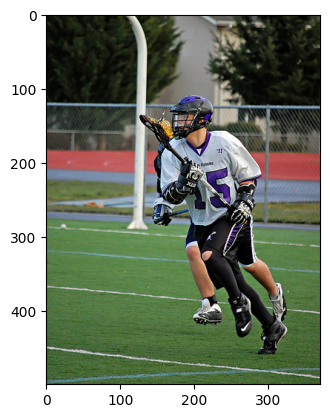

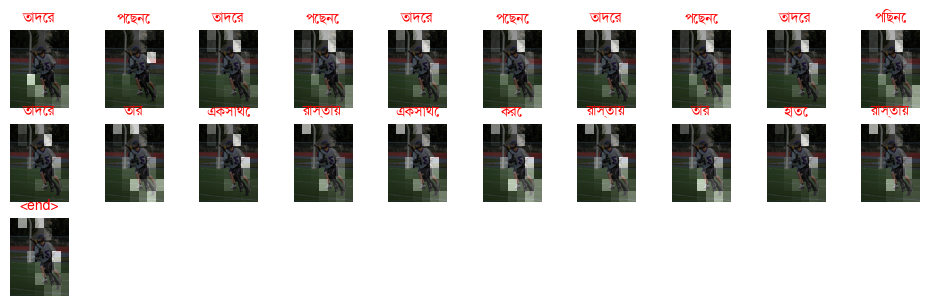

In [ ]:
cap_test_data = test_caption_bancap.copy()
rid = 2408
test_image= test_data_bancap[rid]
real_caption = grouped_bancap.loc[grouped_bancap['filename_bancap'] == test_image, 'captions_bancap'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['কাউবয় টুপি পরা মেয়েটি একটি ভেড়া নিয়ে দাঁড়িয়ে আছে', 'একটি গোলাপী টুপি পরা একটি মেয়ে ধূলিকণা পথে ভেড়ার পাশে হাঁটছে', 'গোলাপি টুপি পরে মেয়েটি একটি ভেড়া নিয়ে হাঁটছে', 'গোলাপি রাখাল টুপি পড়া এক ছোট মেয়ে একটি ফিতায় বাধা ভেড়া ধরে আছে', 'মেয়েটি পিংক রংয়ের রাখালী টুপি এবং পিংক বুট পরেছে']
Prediction Caption: একটি কালো কুকুর আছে
BLEU-1: 18.393972
BLEU-2: 5.591877
BLEU-3: 3.058104
BLEU-4: 2.670111
Meteor Score: 0.117647


ValueError: ignored

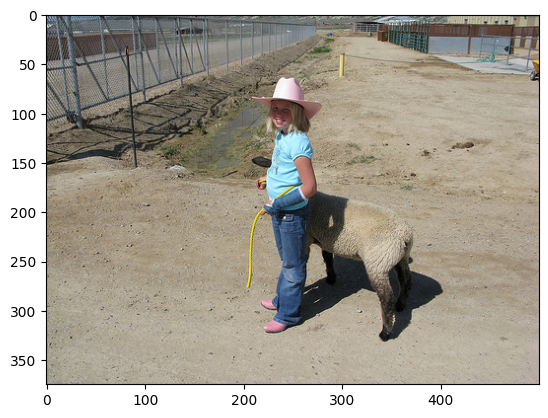

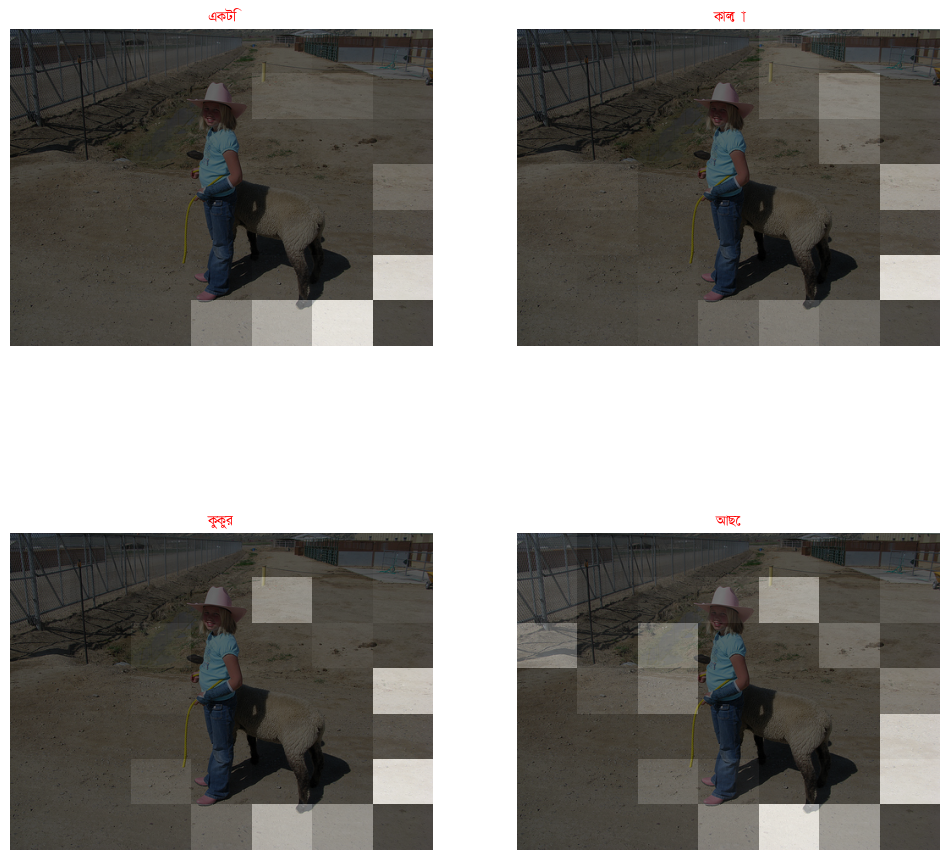

In [ ]:
cap_test_data = test_caption_bancap.copy()
rid = 161
test_image= test_data_bancap[rid]
real_caption = grouped_bancap.loc[grouped_bancap['filename_bancap'] == test_image, 'captions_bancap'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['বৃদ্ধ লোকটি থাম্বস আপ দিচ্ছেন', 'ধূসর দাড়ি এবং ডেনিম টুপিযুক্ত একটি মানুষ হাত দিয়ে থাম্বস আপ সাইন দেয়', 'একটি সাদা কেশিক দাড়ি এবং একটি নীল ক্যাপযুক্ত একটি বৃদ্ধ ব্যক্তি তার ডান হাত দিয়ে থাম্বস আপ সাইন দেয়', 'সাদা দাড়ি ওয়ালা লোকটি বৃদ্ধাঙ্গুলি দেখাচ্ছে', 'সাদা ক্যাপ পড়া বয়স্ক ব্যক্তি থাম্বস আপ দেখাচ্ছে']
Prediction Caption: একজন বিদেশি করে একজন মানুষ দাড়িয়ে আছে
BLEU-1: 14.285714
BLEU-2: 6.806702
BLEU-3: 3.951061
BLEU-4: 3.235935
Meteor Score: 0.040323


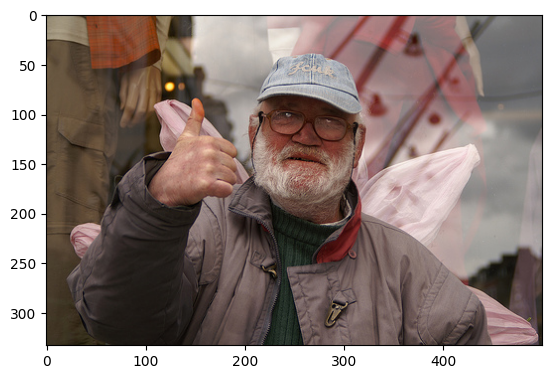

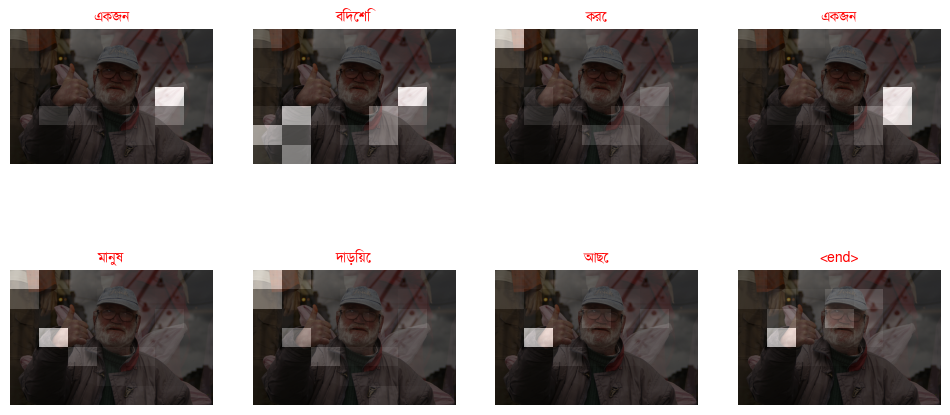

In [ ]:
cap_test_data = test_caption_bancap.copy()
rid = 235
test_image= test_data_bancap[rid]
real_caption = grouped_bancap.loc[grouped_bancap['filename_bancap'] == test_image, 'captions_bancap'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

Real Caption: ['একটি কালো সাদা কুকুর একটি কাঠের তক্তার উপর ভারসাম্য রাখছে', 'কুকুরটি একটি কাঠ দন্ডের উপর হাঁটছে', 'একটি কুকুর প্লাটফর্মের উপরে এক্রোবেটিক কৌশল প্রদর্শন করছে', 'নীল রেলিং এর পাশে লাল কাঠের তক্তার উপর একটি কুকুর হাঁটছে', 'একটি উঁচু তক্তার উপর কুকুরটি হাঁটছে']
Prediction Caption: দূরে গাছপালা দেখা যাচ্ছে
BLEU-1: 0.000000
BLEU-2: 0.000000
BLEU-3: 0.000000
BLEU-4: 0.000000
Meteor Score: 0.000000


ValueError: ignored

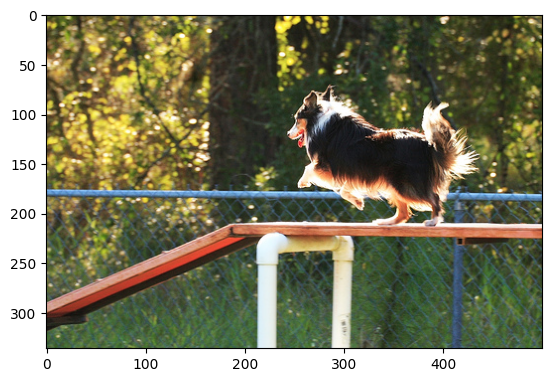

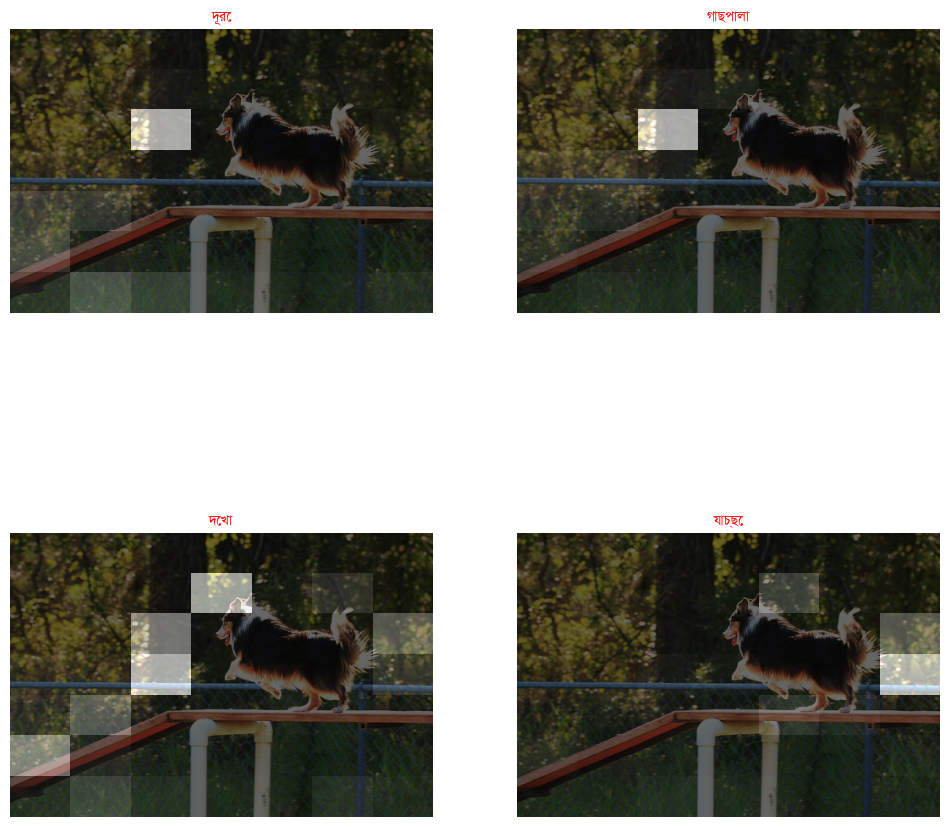

In [ ]:
cap_test_data = test_caption_bancap.copy()
rid = 2935
test_image= test_data_bancap[rid]
real_caption = grouped_bancap.loc[grouped_bancap['filename_bancap'] == test_image, 'captions_bancap'].values[0]
captions_sentences = []
for caption in real_caption:
    sentence = ' '.join(caption)
    captions_sentences.append(sentence)
result, attention_plot, pred_test = evaluate(test_image)
pred_caption=' '.join(result).rsplit(' ', 1)[0]
reference = real_caption
candidate = pred_caption.split()
temp_img = np.array(Image.open(test_image))
plt.imshow(temp_img)
smooth = SmoothingFunction().method4
bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
print ('Real Caption:', captions_sentences)
print ('Prediction Caption:', pred_caption)
print('BLEU-1: %f' % bleu1)
print('BLEU-2: %f' % bleu2)
print('BLEU-3: %f' % bleu3)
print('BLEU-4: %f' % bleu4)

score = meteor_score(reference,candidate)
print('Meteor Score: %f' % score)
plot_attention_map(result, attention_plot, test_image)

In [ ]:
b1_bancap=[]
b2_bancap=[]
b3_bancap=[]
b4_bancap=[]
m_score_bancap = []

for rid in range(0,len(test_data_bancap)):
  test_image= test_data_bancap[rid]
  real_caption = grouped_bancap.loc[grouped_bancap['filename_bancap'] == test_image, 'captions_bancap'].values[0]
  result, attention_plot, pred_test = evaluate(test_image)
  pred_caption=' '.join(result).rsplit(' ', 1)[0]
  reference = real_caption
  candidate = pred_caption.split()
  print(pred_caption)
  smooth = SmoothingFunction().method4
  bleu1 = sentence_bleu(reference, candidate, weights=(1.0, 0, 0, 0), smoothing_function=smooth)*100
  bleu2 = sentence_bleu(reference, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)*100
  bleu3 = sentence_bleu(reference, candidate, weights=(0.33, 0.33, 0.37, 0), smoothing_function=smooth)*100
  bleu4 = sentence_bleu(reference, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)*100
  b1_bancap.append(bleu1)
  b2_bancap.append(bleu2)
  b3_bancap.append(bleu3)
  b4_bancap.append(bleu4)
  score = meteor_score(reference,candidate)
  m_score_bancap.append(score)

কয়েকটি নৌকা রয়েছে
একজন মহিলা আছে
একটি কুকুর বসে আছে
একটি পাহাড় দেখা যাচ্ছে
একটি মানুষ আছে
দুইটি গরু আছে
একটি মেয়েকে দেখা যাচ্ছে
একটি অবয়বের ফেলছে
পানিতে জাল দিয়ে দাঁড়িয়ে আছে
একটি বিশাল মসজিদ দেখা যাচ্ছে
দুটি শিশু আছে
একটি সিংহ এর শিশুকে দেখছে
একটি ক্ষেত দেখা যাচ্ছে
লাল শার্ট পরিধান করে আছেন
একটি কালো কুকুর বসে আছে
একজন মহিলা বসে আছে
সমুদ্রে একটি পাখি দৃশ্যমান
অনেকগুলো মানুষ আর পানি দিচ্ছে
দুইটি গরু আছে
একজন মানুষ দাঁড়িয়ে আছে
একটি ক্যামেরার পাশে একটি জানালা আছে
একটি গাড়ি বিদ্যমান
<end>
একটি বয়স্ক মহিলা দেখা যাচ্ছে
একটি ক্ষেতের সামনে একজন মানুষ রয়েছে
একটি বই আছে
একটি কালো ফুল রয়েছে
একটি সাদা রঙ এর পেছনে অনেকগুলো কালো গরু দেখা যাচ্ছে
একটি সবুজ গাছপালা আছে
একটি কালো গরু আছে
একটি শিশু রয়েছে
একটি লোক দেখা যাচ্ছে
একটি সমুদ্র পাড়ে বসে আছে
কিছু গাছপালা দেখা যাচ্ছে
গাছের উপরে নীল পানির প্যান্ট পড়ে কমরে হাত সুন্দর করে প্যান্ট পড়ে কমরে হাত সুন্দর করে প্যান্ট পড়ে কমরে হাত সুন্দর করে
একটি কালো সাদা গরু আছে
একটি নৌকা ঢাকনা দিয়ে পানি পড়ে বসে আছে
আকাশে অনেক কাশফুল আছে
কয়েকজন লোক কোমড়ে হাত দিয়ে প্যান্ট

In [ ]:
# zero shot with bancap
print('BLEU-1: %f' % np.mean(b1_bancap))
print('BLEU-2: %f' % np.mean(b2_bancap))
print('BLEU-3: %f' % np.mean(b3_bancap))
print('BLEU-4: %f' % np.mean(b4_bancap))

BLEU-1: 20.317987
BLEU-2: 9.047153
BLEU-3: 5.065239
BLEU-4: 4.035193


In [ ]:
print('Meteor Score zero short bancap : %f' % np.mean(m_score_bancap))

Meteor Score zero short bancap : 0.088993
